In [98]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import DecomposeResult, seasonal_decompose
import numpy as np
import pywt
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.stattools import adfuller

from tsfresh import extract_features, select_features
from tsfresh.utilities.dataframe_functions import make_forecasting_frame

import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import boxcox

**Dataset: Metro Interstate Traffic Volume**  
See : https://archive.ics.uci.edu/dataset/492/metro+interstate+traffic+volume  
Hourly Minneapolis-St Paul, MN traffic volume for westbound I-94. Includes weather and holiday features from 2012-2018.   
Hourly weather features and holidays included for impacts on traffic volume.

**1. Import et mise en forme de la donnée**

In [99]:
df = pd.read_csv(r'data\Metro_Interstate_Traffic_Volume.csv.gz', compression='gzip')
print(df.shape)
df.head(5)

(48204, 9)


,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,NaN,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,NaN,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,NaN,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,NaN,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,NaN,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [100]:
df.drop_duplicates(subset=['date_time'], keep='first', inplace=True)
print(df.shape)

(40575, 9)


In [101]:
missing_percentage = (df.isna().sum() / len(df)) * 100
rounded_missing_percentage = round(missing_percentage, 2)
print(rounded_missing_percentage[rounded_missing_percentage > 0])

holiday    99.87
dtype: float64


Pas de valeurs manquantes à part pour la colonne **holiday**.  
Néammoins, on va remarquer que il y a des valeurs manquantes "cachées" : les time stamps ne sont pas continues.  
C'est à dire qu'il y a pas d'observations pour tous les jours et heures.

In [102]:
df['date_time'] = pd.to_datetime(df['date_time'])
start, end = df['date_time'].min(), df['date_time'].max()
full_range = pd.date_range(start=start, end=end, freq='h')

missing_timestamps = full_range.difference(df['date_time'])

print("Timestamps manquants :")
print(len(missing_timestamps) / len(full_range) * 100)


gaps = (missing_timestamps[1:] - missing_timestamps[:-1]) != pd.Timedelta(hours=1)
gap_indices = [0] + (gaps.nonzero()[0] + 1).tolist() + [len(missing_timestamps)]

longest_gap = max(
    (missing_timestamps[gap_indices[i]:gap_indices[i+1]] for i in range(len(gap_indices)-1)),
    key=len
)

print("\nLa plus longue période de données manquantes est de", len(longest_gap), "heures : entre le", longest_gap.min(), "et le", longest_gap.max())


# missing value per year
missing_by_year = pd.Series(missing_timestamps).dt.year.value_counts().sort_index()
print("\nValeurs manquantes par années")
print(missing_by_year)

Timestamps manquants :
22.78929040360792

La plus longue période de données manquantes est de 7386 heures : entre le 2014-08-08 02:00:00 et le 2015-06-11 19:00:00

Valeurs manquantes par années
2012      72
2013    1466
2014    4259
2015    5167
2016     946
2017      47
2018      19
Name: count, dtype: int64


Plusieurs problèmes:
- 23% de valeurs manquantes c'est assez élevé.
- Aucune valeurs quasiment pendant un an (Aout 2014 à Juin 2015) : inimputable

=> On va couper le dataset et ne garder que les 3,5 dernières années à peu près. On peut modifier la date pour réduire les valeurs manquantes quitte à un peu réduire le nombre total d'observation.

In [103]:
df = df[(df["date_time"] >= "2015-10-27 07:00:00")]  # & (df["date_time"] <= "2015-10-27 08:00:00")]
print("Nombre d'observations après tronquage", len(df))
start, end = df['date_time'].min(), df['date_time'].max()
full_range = pd.date_range(start=start, end=end, freq='h')

missing_timestamps = full_range.difference(df['date_time'])

print("\nTimestamps manquants :")
print(len(missing_timestamps) / len(full_range) * 100)

gaps = (missing_timestamps[1:] - missing_timestamps[:-1]) != pd.Timedelta(hours=1)
gap_indices = [0] + (gaps.nonzero()[0] + 1).tolist() + [len(missing_timestamps)]

longest_gap = max(
    (missing_timestamps[gap_indices[i]:gap_indices[i+1]] for i in range(len(gap_indices)-1)),
    key=len
)

print("\nLa plus longue période de données manquantes est de", len(longest_gap), "heures : entre le", longest_gap.min(), "et le", longest_gap.max())


# missing value per year
missing_by_year = (pd.Series(missing_timestamps).dt.year.value_counts()).sort_index()
print(missing_by_year)

Nombre d'observations après tronquage 23979

Timestamps manquants :
6.594733561857276

La plus longue période de données manquantes est de 9 heures : entre le 2017-02-13 16:00:00 et le 2017-02-14 00:00:00
2015    681
2016    946
2017     47
2018     19
Name: count, dtype: int64


On garde quand même plus de 30k pas de temps + 7% de valeurs manquantes qu'il faudra donc imputer

**Remplissage des valeurs manquantes**

Pour l'instant j'ai fait ça pour continuer l'exploration, autres méthodes:  
- Interpolation linéaire / Lagrange  (voir la différence avec ce que on fait là)
- Miss Forest
- MICE
- Un modèle ARIMA prédisant à chaque fois en s'entrainant jus'quà la valeur manquante

### Imputation finale

In [104]:
# merge full_range with df and impute missing value with interpolation
full_df = pd.DataFrame({'date_time': full_range})
df = full_df.merge(df, on='date_time', how='left')
df['holiday'] = df['holiday'].fillna('None')
df[['temp', 'rain_1h', 'snow_1h', 'clouds_all']] = df[['temp', 'rain_1h', 'snow_1h', 'clouds_all']].interpolate(method='linear')
df[['weather_main', 'weather_description']] = df[['weather_main', 'weather_description']].fillna(method='ffill').fillna(method='bfill')
df.set_index("date_time", inplace=True)
df['traffic_volume'] = df['traffic_volume'].interpolate(method='linear')

print(df.isna().sum())
print(len(df))

holiday                0
temp                   0
rain_1h                0
snow_1h                0
clouds_all             0
weather_main           0
weather_description    0
traffic_volume         0
dtype: int64
25672


C:\Users\chemm\AppData\Local\Temp\ipykernel_53884\482987718.py:6: FutureWarning:

DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



In [105]:
df.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,25672.000000,25672.000000,25672.000000,25672.000000,25672.000000
mean,281.707215,0.427575,0.000284,43.853381,3308.275962
std,12.469646,61.361121,0.008459,39.123228,1961.371753
min,243.390000,0.000000,0.000000,0.000000,0.000000
25%,272.590000,0.000000,0.000000,1.000000,1309.375000
50%,282.700000,0.000000,0.000000,40.000000,3503.500000
75%,292.074000,0.000000,0.000000,90.000000,4936.000000
max,310.070000,9831.300000,0.510000,100.000000,7280.000000


**Description des variables**

In [106]:
df["holiday"].value_counts()

holiday
None                         25641
Veterans Day                     3
Thanksgiving Day                 3
Christmas Day                    3
New Years Day                    3
Washingtons Birthday             3
Memorial Day                     3
Independence Day                 3
State Fair                       3
Labor Day                        3
Columbus Day                     2
Martin Luther King Jr Day        2
Name: count, dtype: int64

In [107]:
df["weather_main"].value_counts(normalize=True)

weather_main
Clear           0.339631
Clouds          0.333554
Rain            0.113859
Mist            0.085930
Snow            0.069025
Haze            0.020684
Drizzle         0.016594
Thunderstorm    0.014568
Fog             0.005726
Smoke           0.000428
Name: proportion, dtype: float64

In [108]:
df["weather_description"].value_counts(normalize=True)

weather_description
sky is clear                           0.303054
overcast clouds                        0.113626
broken clouds                          0.092747
scattered clouds                       0.087216
mist                                   0.085930
light rain                             0.060806
light snow                             0.059988
few clouds                             0.039966
moderate rain                          0.038135
Sky is Clear                           0.036577
haze                                   0.020684
proximity thunderstorm                 0.011452
light intensity drizzle                0.011335
heavy intensity rain                   0.010050
snow                                   0.006817
fog                                    0.005726
drizzle                                0.004635
proximity shower rain                  0.004246
thunderstorm                           0.001870
heavy snow                             0.001597
heavy intensity driz

**2. Analyse exploratoire des données**

Text(0.5, 1.0, 'Traffic Volume Over Time')

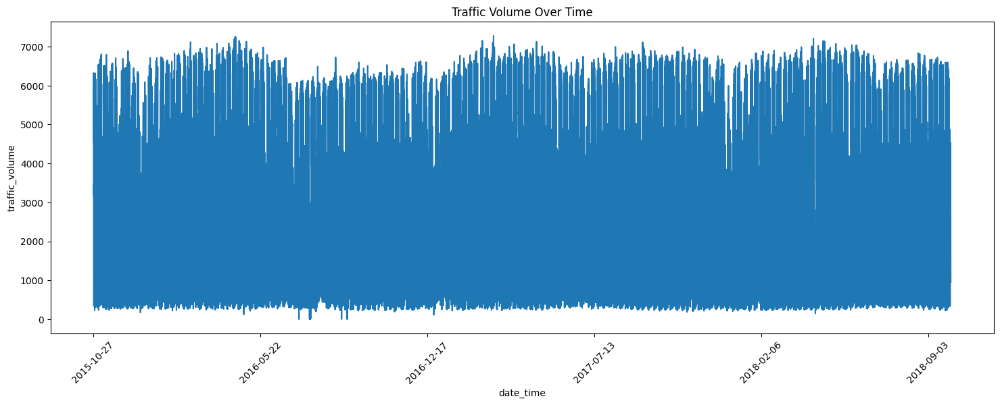

In [109]:
plt.figure(figsize=(18, 6))
sns.lineplot(x=df.index, y='traffic_volume', data=df)
plt.xticks(df.index[::5000], rotation=45)
plt.title('Traffic Volume Over Time')

# 📈 Analyse du Graphique : Volume de Trafic dans le Temps

Le graphique présenté illustre l’évolution du **volume de trafic** sur une période de plusieurs années, offrant une vue d'ensemble des dynamiques temporelles observées.

---

## Observations Clés

### Fluctuations Régulières
- Présence de **pics** et de **creux** récurrents, reflétant des **cycles journaliers** et **hebdomadaires** caractéristiques des schémas de trafic urbain.
- **Volume de trafic plus élevé** durant les **heures de pointe** (matin et soir) et diminution notable pendant les périodes creuses, notamment la nuit.

---

###  Anomalies et Discontinuités
- **Gaps visibles** où le volume de trafic est quasi nul, correspondant aux **périodes de données manquantes** identifiées précédemment.
- Certains points exceptionnellement bas peuvent indiquer des **anomalies** spécifiques.

---

### Tendance Générale
- Densité des données **plus importante à partir de 2016**, suggérant une **amélioration de la couverture des données** ou des ajustements dans les méthodes de collecte.
- **Pas de tendance nette à la hausse ou à la baisse** sur l’ensemble de la période. Une analyse plus fine sur des plages temporelles spécifiques pourrait révéler des tendances saisonnières ou des variations structurelles du trafic.

---

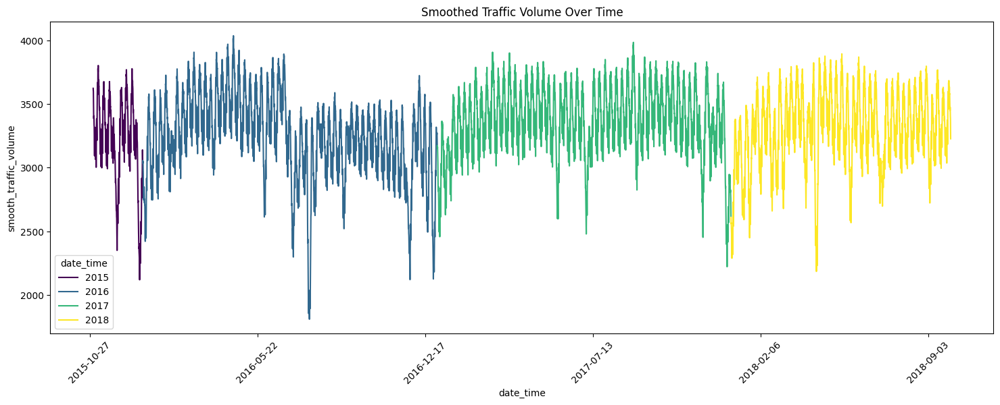

In [110]:
df['smooth_traffic_volume'] = df['traffic_volume'].rolling(window=100).mean()
colors = df.index.year
plt.figure(figsize=(18, 6))
sns.lineplot(x=df.index, y='smooth_traffic_volume', data=df, hue=colors, palette='viridis')
plt.xticks(df.index[::5000], rotation=45)
plt.title('Smoothed Traffic Volume Over Time')
plt.show()

# 📈 Analyse du Graphique : Volume de Trafic Lissé dans le Temps

Ce graphique illustre l’évolution du **volume de trafic lissé** sur plusieurs années, mettant en évidence des tendances générales et des variations saisonnières.
---


### Tendance Générale
- On observe une **hausse progressive** du volume de trafic entre 2015 et 2018, bien que la tendance ne soit pas parfaitement linéaire.
- Le volume de trafic semble plus **stable** à partir de 2017, ce qui pourrait refléter une évolution des comportements de mobilité ou une amélioration des méthodes de collecte des données.

---

###  Variabilité Saisonnière
- Des **cycles saisonniers** récurrents sont visibles, caractérisés par des **pics réguliers** correspondant probablement aux **jours ouvrés** et des **creux** associés aux **week-ends** ou **jours fériés**.
- Les périodes de **baisse marquée** du trafic peuvent coïncider avec des périodes de vacances, telles que l’été ou la fin d’année.

---

###  Discontinuités et Anomalies
- Présence de **discontinuités visibles** dans la série, notamment en 2016 et début 2017, correspondant à des **périodes de données manquantes** identifiées lors de l’analyse exploratoire.
---


---

Text(0.5, 1.0, 'Wavelet Decomposition')

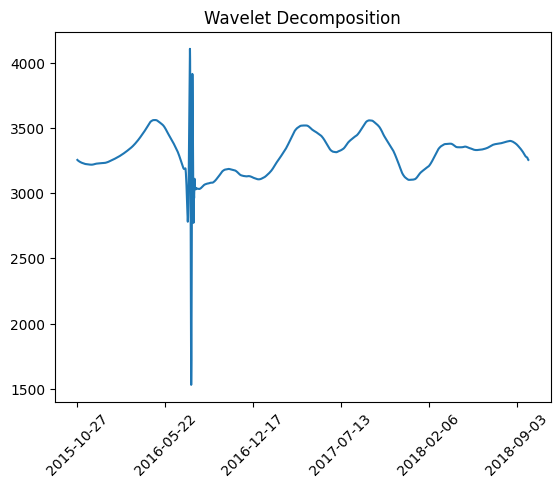

In [111]:
traffic_volume = df['traffic_volume']
coeff = pywt.wavedec(traffic_volume, 'db4', mode="per")
mean_coeff = np.mean([abs(ele - np.mean(traffic_volume)) for ele in traffic_volume])
sigma = (1 / 0.6745) * mean_coeff
threshhold = sigma * np.sqrt(2 * np.log(len(traffic_volume)))
coeff[1:] = (pywt.threshold(i, value=threshhold, mode='hard') for i in coeff[1:])
traffic_volume_wavelet_decomp = pywt.waverec(coeff, 'db4', mode='per')

plt.plot(df.index, traffic_volume_wavelet_decomp)
plt.xticks(df.index[::5000], rotation=45)
plt.title('Wavelet Decomposition')


# 🌊 Analyse de la Décomposition en Ondelettes (Wavelet Decomposition)

Ce graphique illustre le résultat de la **décomposition en ondelettes** appliquée au volume de trafic.
---

###  Tendance Générale
- La courbe met en évidence des **fluctuations de bas niveau** représentant la tendance de fond du volume de trafic.
- On observe des **oscillations régulières** correspondant à des cycles saisonniers ou des variations périodiques sur le long terme.

---

### Comportements Anormaux
- Une **forte volatilité** est visible autour de la période de mi-2016, caractérisée par des **pics extrêmes** et des **variations soudaines**. 
---

### Identification des Cycles
- Les ondulations régulières après 2016 reflètent des **cycles périodiques** : variations hebdomadaires, mensuelles ou saisonnières.
- L’**amplitude des cycles** semble diminuer après 2017, ce qui pourrait indiquer une stabilisation du trafic ou des ajustements dans la collecte des données.

---

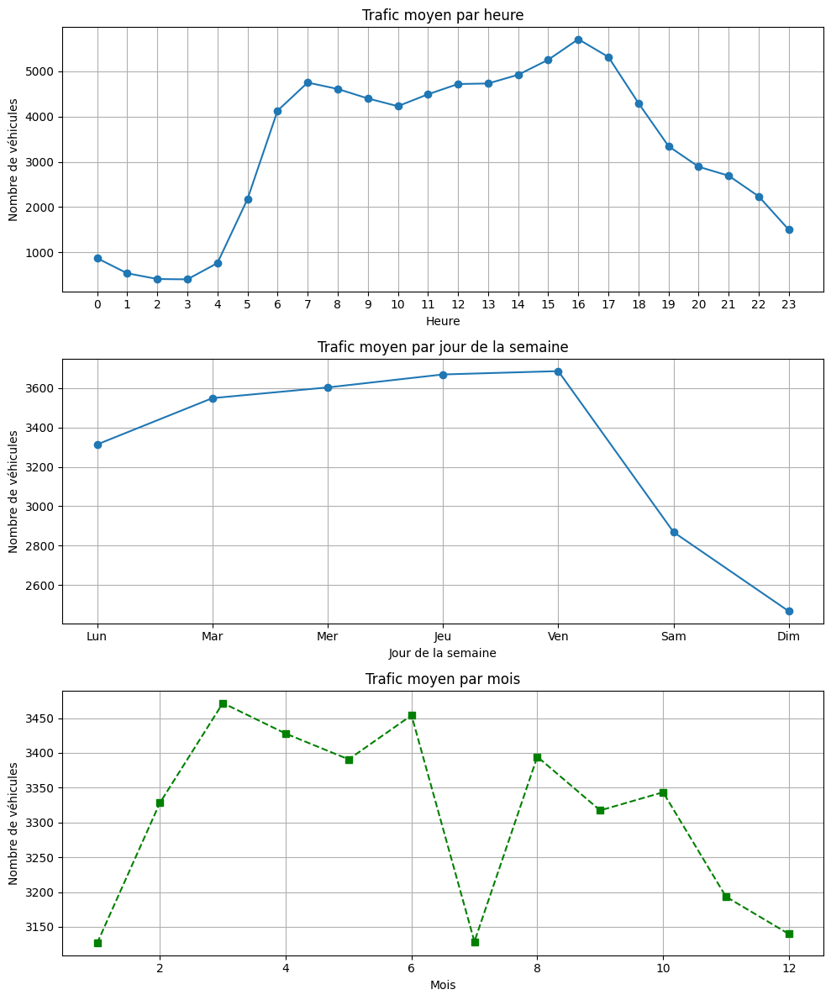

In [112]:
df["Hour"] = df.index.hour
df["Day"] = df.index.dayofweek 
df["Month"] = df.index.month

hourly_traffic = df.groupby("Hour")["traffic_volume"].mean()
daily_traffic = df.groupby("Day")["traffic_volume"].mean()
monthly_traffic = df.groupby("Month")["traffic_volume"].mean()

fig, axes = plt.subplots(3, 1, figsize=(10, 12))

axes[0].plot(hourly_traffic.index, hourly_traffic.values, marker='o')
axes[0].set_title("Trafic moyen par heure")
axes[0].set_xlabel("Heure")
axes[0].set_ylabel("Nombre de véhicules")
axes[0].grid(True)
axes[0].set_xticks(hourly_traffic.index)


axes[1].plot(daily_traffic.index, daily_traffic.values, marker='o', linestyle='-')
axes[1].set_xticks(range(7))
axes[1].set_xticklabels(["Lun", "Mar", "Mer", "Jeu", "Ven", "Sam", "Dim"])
axes[1].set_title("Trafic moyen par jour de la semaine")
axes[1].set_xlabel("Jour de la semaine")
axes[1].set_ylabel("Nombre de véhicules")
axes[1].grid(True)

axes[2].plot(monthly_traffic.index, monthly_traffic.values, marker='s', linestyle='--', color='g')
axes[2].set_title("Trafic moyen par mois")
axes[2].set_xlabel("Mois")
axes[2].set_ylabel("Nombre de véhicules")
axes[2].grid(True)

plt.tight_layout()
plt.show()

# 🚗 Analyse du Trafic Moyen

Ces trois graphiques illustrent l’évolution du **trafic moyen** en fonction de l'heure, du jour de la semaine et du mois. Cette analyse permet de mieux comprendre les schémas de trafic récurrents et d’identifier les périodes de forte ou faible affluence.

---

## Trafic Moyen par Heure

- Le trafic est **très faible entre minuit et 5h du matin**, avec un minimum autour de 3h.
- À partir de **6h**, une forte augmentation est observée, atteignant un **pic entre 7h et 8h**, correspondant à l’**heure de pointe matinale**.
- Un second **pic significatif vers 16h-17h**, typique des **heures de sortie de bureau**.
- Le trafic diminue progressivement après 18h, pour revenir à des niveaux bas en fin de soirée.
- Ce schéma est caractéristique d’un trafic influencé par des **déplacements domicile-travail**.

---

##  Trafic Moyen par Jour de la Semaine

- Le **trafic est le plus élevé du lundi au vendredi**, avec un **pic le jeudi et vendredi**, signe d’une activité intense en semaine.
- Le **week-end (samedi et dimanche)** enregistre une **baisse significative du trafic**, en particulier le dimanche, jour de trafic le plus faible.
- La différence nette entre semaine et week-end reflète un trafic dominé par les **activités professionnelles** en semaine et des déplacements plus sporadiques le week-end.

---

##  Trafic Moyen par Mois

- Le trafic reste **relativement stable tout au long de l'année**, avec quelques variations :
  - **Pic en mars et juin**, indiquant des périodes d’activité plus soutenue.
  - **Baisse notable en juillet et août**, probablement en raison des **vacances d’été**.
  - Légère diminution du trafic en décembre, en lien avec les **fêtes de fin d'année**.
- La baisse estivale et hivernale est typique des périodes de vacances, où les déplacements domicile-travail diminuent.

---

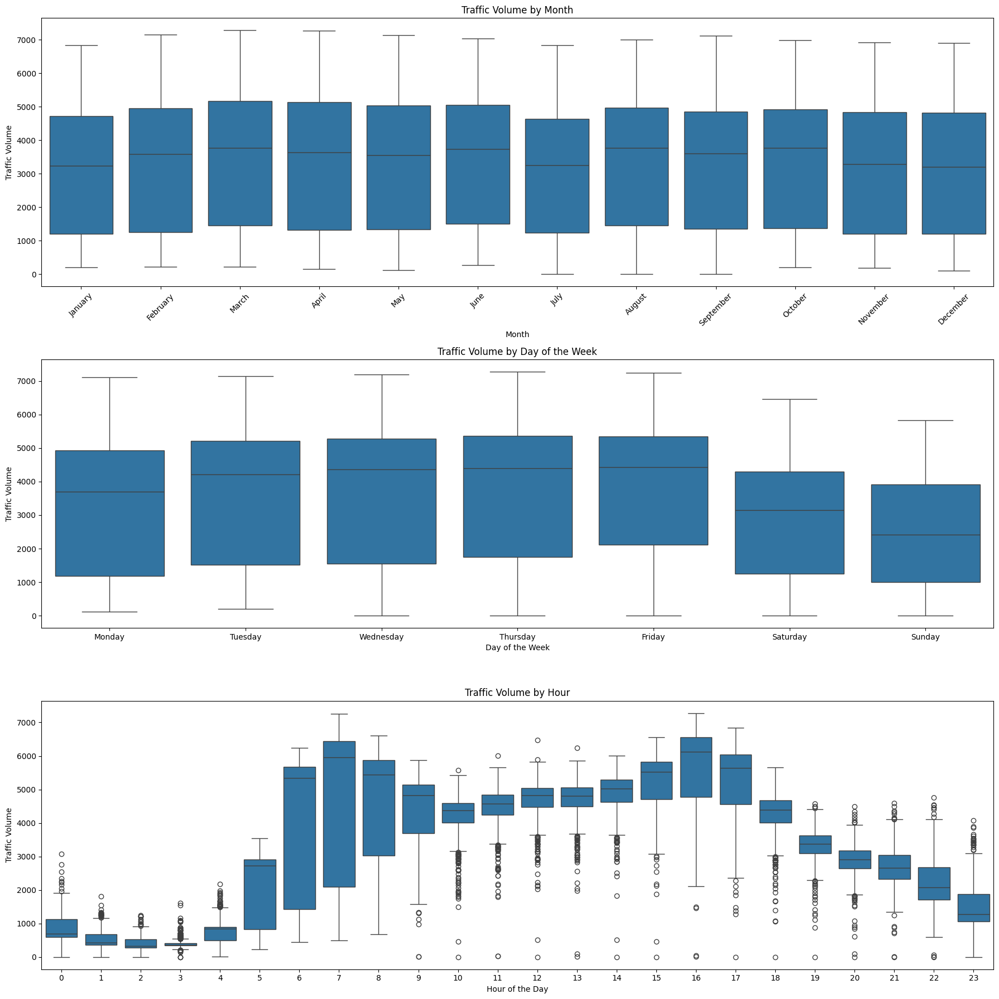

In [113]:
df['Month'] = pd.Categorical(df.index.month_name(), categories=[
    'January', 'February', 'March', 'April', 'May', 'June', 
    'July', 'August', 'September', 'October', 'November', 'December'
], ordered=True)

df['Day'] = pd.Categorical(df.index.day_name(), categories=[
    'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'
], ordered=True)
df['Hour'] = df.index.hour

fig, axes = plt.subplots(3, 1, figsize=(18, 18)) 

sns.boxplot(x='Month', y='traffic_volume', data=df, ax=axes[0])
axes[0].set_title('Traffic Volume by Month')
axes[0].set_xlabel('Month')
axes[0].set_ylabel('Traffic Volume')
axes[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='Day', y='traffic_volume', data=df, ax=axes[1])
axes[1].set_title('Traffic Volume by Day of the Week')
axes[1].set_xlabel('Day of the Week')
axes[1].set_ylabel('Traffic Volume')

sns.boxplot(x='Hour', y='traffic_volume', data=df, ax=axes[2])
axes[2].set_title('Traffic Volume by Hour')
axes[2].set_xlabel('Hour of the Day')
axes[2].set_ylabel('Traffic Volume')

plt.tight_layout()
plt.show()


# 📊 Analyse du Volume de Trafic

Ce document présente l'analyse de trois boxplots illustrant la distribution du **volume de trafic** selon trois dimensions temporelles clés : **mois**, **jour de la semaine**, et **heure de la journée**. Ces visualisations permettent de mieux comprendre les schémas de mobilité et d'identifier des tendances significatives.

---

## Traffic Volume par Mois

- **Tendance Générale :**
  - Le volume de trafic reste relativement **stable tout au long de l'année**, avec des médianes similaires entre les mois.
  - Aucune variation saisonnière marquée, bien que l'on puisse observer de **légères fluctuations** dans la dispersion des données.

- **Variabilité :**
  - Les **écarts interquartiles (IQR)** sont similaires, montrant une **dispersion modérée** du trafic chaque mois.
  - **Présence d'outliers** dans tous les mois, reflétant des pics de trafic exceptionnels, possiblement liés à des événements ponctuels.


  - La stabilité mensuelle suggère un trafic régulier, peu influencé par des facteurs saisonniers majeurs, à l'exception de quelques variations mineures.

---

##  Traffic Volume par Jour de la Semaine

- **Tendance Hebdomadaire :**
  - Le trafic est **plus élevé en semaine (lundi à vendredi)**, avec une médiane qui diminue significativement le **samedi** et atteint son plus bas le **dimanche**.
  - Cela reflète des **schémas typiques de déplacements domicile-travail**, où l’activité diminue pendant le week-end.

- **Dispersion :**
  - La **dispersion est plus importante en semaine**, ce qui peut indiquer des variations liées aux heures de pointe.
  - **Moins de variabilité le week-end**, probablement en raison de schémas de trafic plus homogènes et moins soumis aux contraintes horaires.

- **Présence d'Outliers :**
  - Des **outliers fréquents** en semaine, souvent associés à des pics de trafic inattendus (accidents, événements spéciaux, conditions météo).

---

##  Traffic Volume par Heure de la Journée

- **Schéma Journalier :**
  - Le trafic est **très faible entre minuit et 5h du matin**, avec une augmentation marquée à partir de **6h**.
  - Deux **pics distincts** :
    - **Matin (7h-9h)** : Pic correspondant à l'**heure de pointe matinale**.
    - **Après-midi (16h-18h)** : Pic reflétant l'**heure de sortie de bureau**.
  - **Diminution progressive** après 19h jusqu'à minuit.

- **Variabilité :**
  - Forte **dispersion pendant les heures de pointe**, signe de fluctuations importantes dues aux conditions de circulation.
  - Moins de variabilité en dehors des heures de pointe, notamment la nuit.

- **Outliers :**
  - De nombreux **outliers identifiés en dehors des heures de pointe**, probablement dus à des événements imprévus affectant ponctuellement le trafic.

---

##  Insights

- **Régularité du trafic** sur le plan mensuel, avec des variations limitées, sauf en cas d'événements exceptionnels.
- **Importance des schémas hebdomadaires**, le trafic étant clairement influencé par les jours ouvrés par rapport au week-end.
- **Cyclicité horaire bien marquée**, soulignant les heures de pointe comme des périodes critiques pour la gestion du trafic.

---

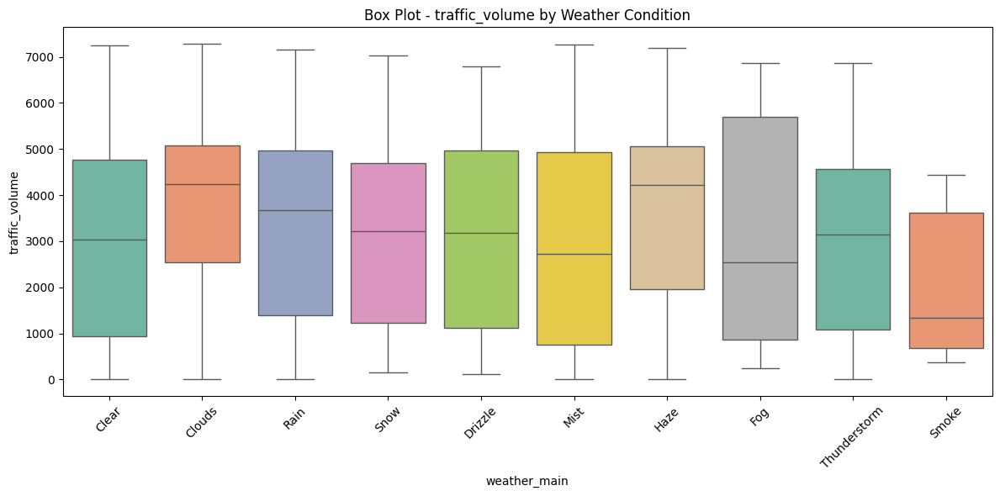

In [114]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='weather_main', y='traffic_volume', hue='weather_main', data=df, palette='Set2', legend=False)
plt.title('Box Plot - traffic_volume by Weather Condition')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

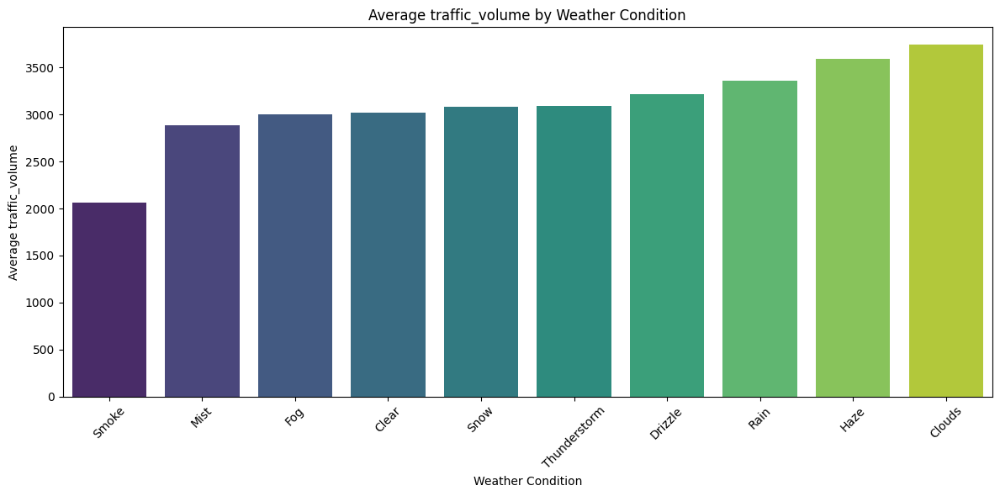

In [115]:
weather_traffic = df.groupby("weather_main", observed=True)["traffic_volume"].mean().sort_values()
plt.figure(figsize=(12, 6))
sns.barplot(x=weather_traffic.index, y=weather_traffic.values, hue=weather_traffic.index, palette='viridis', dodge=False, legend=False)
plt.title('Average traffic_volume by Weather Condition')
plt.xlabel('Weather Condition')
plt.ylabel('Average traffic_volume')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 🌦️ Analyse du Volume de Trafic en Fonction des Conditions Météorologiques

Cette analyse explore l'impact des différentes **conditions météorologiques** sur le **volume de trafic**. Deux visualisations sont utilisées pour cette étude :
1. Un **boxplot** pour analyser la distribution du volume de trafic par condition météo.
2. Un **barplot** pour visualiser le volume de trafic moyen selon la météo.

---

##  Boxplot : Volume de Trafic par Condition Météorologique

- Le volume de trafic est relativement **variable** en fonction des conditions météorologiques.
- **Conditions avec une forte dispersion du trafic :**
  - **Mist, Fog, Haze** : Présentent des écarts interquartiles (IQR) importants, indiquant une **grande variabilité du trafic**.
  - **Thunderstorm** et **Snow** : Affichent des **outliers fréquents**, suggérant des pics de trafic inhabituels en raison d'événements exceptionnels (accidents, ralentissements, etc.).

- **Conditions avec une dispersion plus faible :**
  - **Clear** et **Clouds** : La distribution est plus **concentrée**, signe d’une circulation plus prévisible par temps clair ou nuageux.

- Les conditions météorologiques extrêmes comme le **brouillard (Fog)**, la **brume (Mist)** ou les **tempêtes (Thunderstorm)** peuvent entraîner des **ralentissements** et des **variations imprévisibles** du trafic.
- En revanche, par **temps clair (Clear)** ou **nuageux (Clouds)**, le trafic est plus **régulier** et prévisible.

---

##  Barplot : Volume de Trafic Moyen par Condition Météorologique

- Le **volume de trafic moyen le plus élevé** est observé sous des conditions de **Clouds** et de **Haze**.
- Le **volume de trafic le plus faible** est constaté par temps de **Smoke** (fumée), suivi de conditions de **Mist** et de **Fog**.
- **Conditions modérées (Clear, Rain, Drizzle)** montrent un **trafic moyen stable**, ce qui suggère que ces conditions n’affectent pas significativement la densité de circulation.

- **Clouds et Haze** sont des conditions météo courantes, ce qui peut expliquer des volumes de trafic élevés.
- Le faible volume de trafic lors de conditions de **Smoke** peut être dû à des situations exceptionnelles (incendies, pollution dense) qui limitent la mobilité des véhicules.
- La **pluie (Rain)** et la **neige (Snow)** n’ont pas un impact négatif aussi important que prévu sur le volume moyen, bien que la **dispersion** des valeurs (observée dans le boxplot) indique des effets ponctuels plus marqués.

---

1. **Conditions météo extrêmes** (brouillard, brume, fumée) peuvent entraîner des **variations importantes** du trafic et des baisses significatives du volume de circulation.
2. Les conditions **climatiques courantes** (nuageux, clair) ont un impact modéré sur la circulation, avec un volume de trafic plus élevé et plus stable.
3. Il est essentiel de **surveiller l'impact des conditions météorologiques extrêmes** sur le trafic pour anticiper les risques de congestion et d'accidents.

---



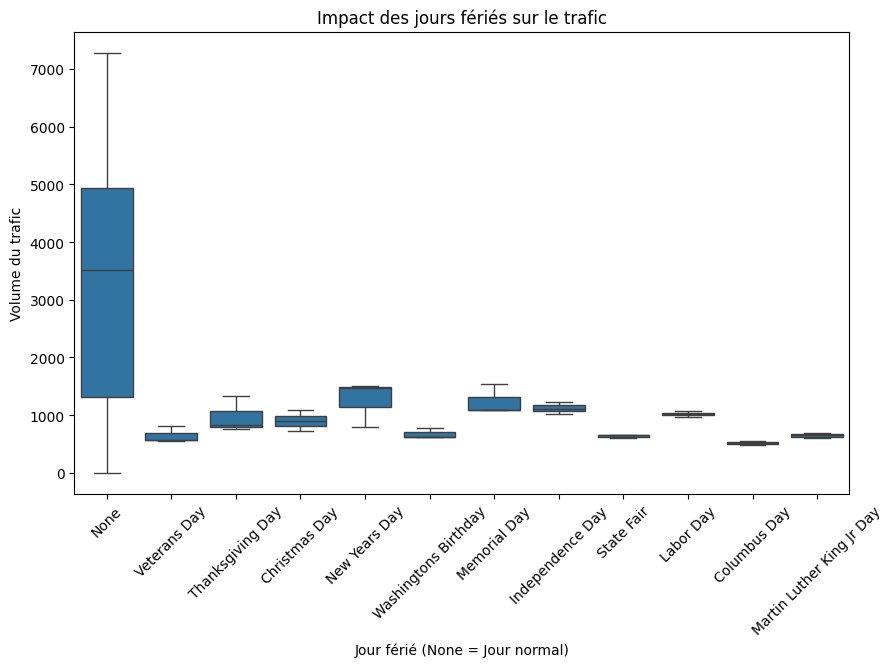

In [116]:
plt.figure(figsize=(10,6))
sns.boxplot(x=df["holiday"], y=df["traffic_volume"])
plt.xlabel("Jour férié (None = Jour normal)")
plt.ylabel("Volume du trafic")
plt.title("Impact des jours fériés sur le trafic")
plt.xticks(rotation=45)
plt.show()

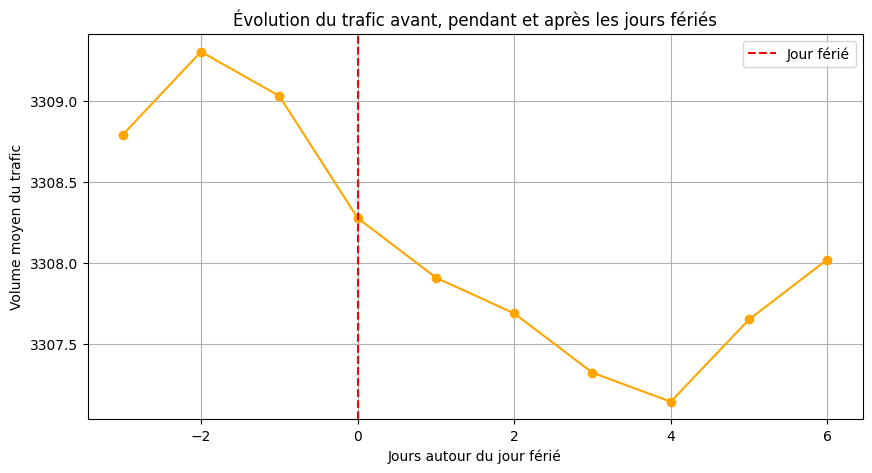

In [117]:
df_new=df.copy()
df_new=df_new.reset_index()
df_new["date_time"] = pd.to_datetime(df_new["date_time"])

holiday_dates = df_new[df_new["holiday"].notna()]["date_time"].unique()

traffic_trend = []

for holiday in holiday_dates:
    for day_shift in range(-3, 7):
        date_to_check = holiday + pd.Timedelta(days=day_shift)
        traffic_on_date = df_new[df_new["date_time"] == date_to_check]

        if not traffic_on_date.empty:
            avg_traffic = traffic_on_date["traffic_volume"].mean()
            traffic_trend.append({"Day Shift": day_shift, "Average Traffic Volume": avg_traffic})

df_trend = pd.DataFrame(traffic_trend)

df_trend_grouped = df_trend.groupby("Day Shift").mean().reset_index()

plt.figure(figsize=(10, 5))
plt.plot(df_trend_grouped["Day Shift"], df_trend_grouped["Average Traffic Volume"], marker='o', linestyle='-', color='orange')

plt.axvline(0, color='r', linestyle='--', label="Jour férié")  
plt.xlabel("Jours autour du jour férié")
plt.ylabel("Volume moyen du trafic")
plt.title("Évolution du trafic avant, pendant et après les jours fériés")
plt.legend()
plt.grid(True)

plt.show()


# 🎉 Impact des Jours Fériés sur le Volume de Trafic  

Cette analyse explore comment les **jours fériés influencent la circulation routière** en examinant deux visualisations :  

1. **Un boxplot** montrant la **distribution du volume de trafic** selon les jours fériés.  
2. **Un line plot** analysant l’**évolution du trafic avant, pendant et après les jours fériés**.  

---

## 📌 **Boxplot : Distribution du Trafic par Jour Férié**  

- **Tendance générale** : Le trafic est **significativement plus faible les jours fériés** comparé aux jours normaux.  
- **Jours fériés avec un impact marqué** :
  - **Labor Day, Columbus Day, et Martin Luther King Jr Day** montrent un **trafic très réduit**, probablement en raison d’un ralentissement général des déplacements.  
  - **Christmas Day et Thanksgiving** présentent également un **faible volume de trafic**, ce qui suggère que la plupart des gens restent chez eux.  
- **Exceptions :**
  - **New Year’s Day et Memorial Day** montrent un volume de trafic **relativement plus élevé**, probablement en raison des voyages et des célébrations.  
  - **Independence Day et Washington’s Birthday** affichent une variabilité plus importante, avec des valeurs extrêmes indiquant des **périodes de trafic intense et calme** selon l’heure et l’emplacement.  

---

## 🔄 **Évolution du Trafic Avant, Pendant et Après un Jour Férié**  

- **📉 Baisse progressive avant le jour férié** : On observe une **réduction progressive du trafic** les jours précédents, suggérant que les déplacements sont **anticipés** (ex. départs en vacances).  
- **🔴 Chute marquée le jour du jour férié** : Le volume de trafic atteint un **minimum le jour même**, ce qui confirme une **activité réduite sur les routes**.  
- **📈 Reprise progressive après le jour férié** : Après le jour férié, le trafic **reste faible mais reprend progressivement**, indiquant un **retour à la normale progressif**.  

Cette tendance est typique des **jours fériés**, où les déplacements sont concentrés **avant** et **après**, avec un creux notable le jour même.  



In [118]:
result = seasonal_decompose(df["traffic_volume"], model='additive')

def plot_seasonal_decompose(result: DecomposeResult, title="Seasonal Decomposition"):
    return (
        make_subplots(
            rows=4,
            cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],
        )
        .add_trace(
            go.Scatter(x=result.seasonal.index, y=result.observed, mode="lines"),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=result.trend.index, y=result.trend, mode="lines"),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=result.seasonal.index, y=result.seasonal, mode="lines"),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=result.resid.index, y=result.resid, mode="lines"),
            row=4,
            col=1,
        )
        .update_layout(
            height=900, title=title, margin=dict(t=100), title_x=0.5, showlegend=False
        )
    )

plot_seasonal_decompose(result).show()

# 📊 Analyse de la Décomposition Saisonnière du Volume de Trafic

Cette décomposition saisonnière permet d'analyser le volume de trafic à travers ses différentes composantes : **observée**, **tendance**, **saisonnalité**, et **résidus**. L'objectif est de comprendre la structure sous-jacente des données et d'identifier des motifs récurrents ou des anomalies.

---

##  Observed (Données Observées)

- Le graphique montre les **données brutes du volume de trafic** sur la période analysée (2015-2018).
- On observe des **fluctuations régulières**, probablement liées à des **cycles journaliers et hebdomadaires**.
- Certains **creux soudains** peuvent indiquer des périodes de **données manquantes**, des jours fériés ou des événements exceptionnels (conditions météo extrêmes, accidents, etc.).

---

##  Trend (Tendance à Long Terme)

- La courbe de tendance révèle des **variations lentes** du trafic sur la période.
- **Tendance globale stable**, bien que des fluctuations soient visibles :
  - **Légère hausse** du volume de trafic vers la fin de la période, suggérant un possible **accroissement de la circulation**.
  - **Chutes soudaines** de la tendance à certains points (notamment vers mi-2016 et début 2018), probablement dues à des **perturbations majeures** ou des périodes de données manquantes.

- La tendance est influencée par des facteurs à long terme tels que la **croissance démographique**, les **modifications des infrastructures routières**, ou des **changements de comportement des usagers**.

---

##  Seasonal (Composante Saisonnière)

- La composante saisonnière est très **prononcée et régulière**, avec des motifs récurrents sur toute la période.
- On observe des **pics et des creux bien définis**, probablement liés à :
  - Des **heures de pointe quotidiennes** (matin et soir).
  - Des **cycles hebdomadaires** : trafic plus intense en semaine, plus faible le week-end.
  
- La saisonnalité est stable, ce qui indique des **habitudes de déplacement constantes** sur la période. 
- Ces motifs peuvent être exploités pour des **modèles de prévision du trafic**, car ils sont prévisibles et récurrents.

---

##  Residuals (Résidus)

- Les résidus représentent les **écarts entre les données réelles et les valeurs prédites par la tendance + saisonnalité**.
- Ils sont généralement **centrés autour de zéro**, ce qui est un bon signe d’un modèle bien ajusté.
- **Pics extrêmes** visibles dans les résidus :
  - Indiquent des **anomalies** ou des événements inattendus, comme des **accidents**, des **fermetures de routes**, des **manifestations**, ou des **conditions météorologiques extrêmes**.
- Les résidus permettent d'identifier des événements ponctuels non expliqués par des tendances régulières. 
- L’analyse de ces anomalies peut aider à comprendre les **facteurs externes** influençant le trafic.

---

- Le volume de trafic est fortement influencé par des **cycles saisonniers réguliers** (quotidiens et hebdomadaires).
- La **tendance à long terme** est relativement stable avec quelques perturbations ponctuelles.
- Les **résidus** mettent en évidence des anomalies qu'il serait intéressant d'explorer plus en détail.

---

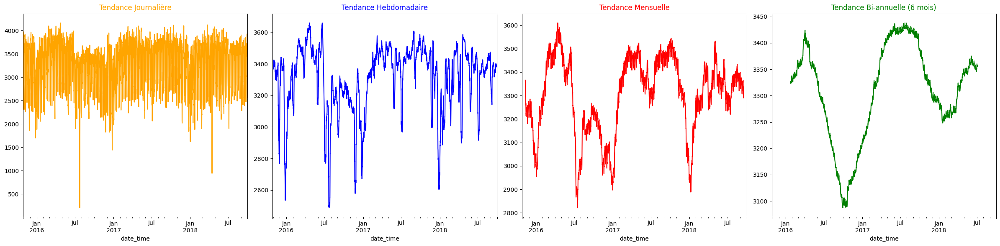

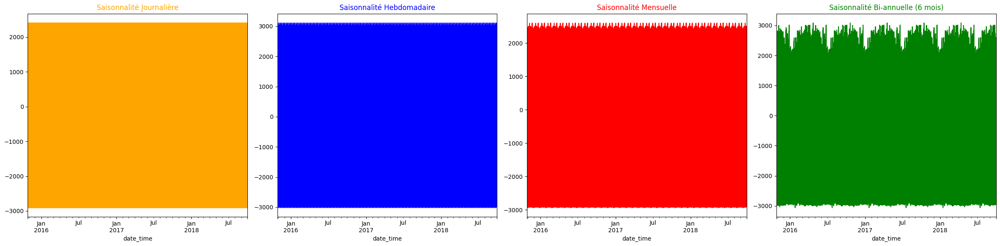

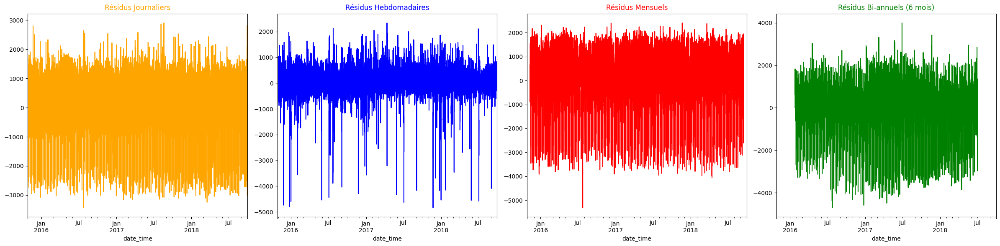

In [119]:
decomp_daily = seasonal_decompose(df["traffic_volume"], model="additive", period=24)
decomp_weekly = seasonal_decompose(df["traffic_volume"], model="additive", period=24*7)
decomp_monthly = seasonal_decompose(df["traffic_volume"], model="additive", period=24*30)
decomp_biannual = seasonal_decompose(df["traffic_volume"], model="additive", period=24*30*6)

colors = {
    "daily": "orange",
    "weekly": "blue",
    "monthly": "red",
    "biannual": "green"
}

fig, axes = plt.subplots(1, 4, figsize=(24, 6))

axes[0].set_title("Tendance Journalière", color=colors["daily"])
decomp_daily.trend.plot(ax=axes[0], color=colors["daily"])

axes[1].set_title("Tendance Hebdomadaire", color=colors["weekly"])
decomp_weekly.trend.plot(ax=axes[1], color=colors["weekly"])

axes[2].set_title("Tendance Mensuelle", color=colors["monthly"])
decomp_monthly.trend.plot(ax=axes[2], color=colors["monthly"])

axes[3].set_title("Tendance Bi-annuelle (6 mois)", color=colors["biannual"])
decomp_biannual.trend.plot(ax=axes[3], color=colors["biannual"])

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 4, figsize=(24, 6))

axes[0].set_title("Saisonnalité Journalière", color=colors["daily"])
decomp_daily.seasonal.plot(ax=axes[0], color=colors["daily"])

axes[1].set_title("Saisonnalité Hebdomadaire", color=colors["weekly"])
decomp_weekly.seasonal.plot(ax=axes[1], color=colors["weekly"])

axes[2].set_title("Saisonnalité Mensuelle", color=colors["monthly"])
decomp_monthly.seasonal.plot(ax=axes[2], color=colors["monthly"])

axes[3].set_title("Saisonnalité Bi-annuelle (6 mois)", color=colors["biannual"])
decomp_biannual.seasonal.plot(ax=axes[3], color=colors["biannual"])

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 4, figsize=(24, 6))

axes[0].set_title("Résidus Journaliers", color=colors["daily"])
decomp_daily.resid.plot(ax=axes[0], color=colors["daily"])

axes[1].set_title("Résidus Hebdomadaires", color=colors["weekly"])
decomp_weekly.resid.plot(ax=axes[1], color=colors["weekly"])

axes[2].set_title("Résidus Mensuels", color=colors["monthly"])
decomp_monthly.resid.plot(ax=axes[2], color=colors["monthly"])

axes[3].set_title("Résidus Bi-annuels (6 mois)", color=colors["biannual"])
decomp_biannual.resid.plot(ax=axes[3], color=colors["biannual"])

plt.tight_layout()
plt.show()


# 📊 Analyse Détaillée du Volume de Trafic : Tendance, Saisonnalité et Résidus

Cette analyse explore la **dynamique du volume de trafic** à travers trois dimensions clés : la **tendance**, la **saisonnalité** et les **résidus**. Ces éléments sont étudiés à différentes échelles temporelles : **journalière**, **hebdomadaire**, **mensuelle**, et **bi-annuelle (6 mois)**.

---

##  Tendance Temporelle
- **Tendance Journalière :**
  - Fluctuations significatives avec des **pics et des creux réguliers**, liés à des variations journalières typiques (heures de pointe, jours ouvrés vs week-ends).
  - **Chutes soudaines** probablement dues à des événements exceptionnels (jours fériés, incidents, conditions météorologiques extrêmes).

- **Tendance Hebdomadaire :**
  - Mise en évidence d’un **cycle hebdomadaire clair**, marqué par une augmentation du trafic en semaine et une diminution les week-ends.
  - Présence de **variations saisonnières à court terme** correspondant aux changements de rythme hebdomadaire (vacances scolaires, jours fériés).

- **Tendance Mensuelle :**
  - Identification de **cycles saisonniers plus larges**. On observe des baisses pendant les périodes estivales et hivernales, en lien avec les vacances.
  - Les fluctuations plus douces révèlent des **tendances structurelles** à moyen terme.

- **Tendance Bi-annuelle (6 mois) :**
  - Mise en évidence de **cycles longs**, probablement influencés par des tendances économiques globales, des travaux d’infrastructure ou des modifications des comportements de mobilité.
  - Les **variations sont plus lissées**, illustrant des **tendances structurelles à long terme**.

---

##  Saisonnalité Temporelle
- **Saisonnalité Journalière :**
  - Présence de **motifs répétitifs quotidiens** indiquant des schémas de trafic constants, liés aux habitudes de déplacement (heures de pointe du matin et du soir).
  - Les valeurs extrêmes peuvent représenter des anomalies de collecte de données ou des événements rares.

- **Saisonnalité Hebdomadaire :**
  - Schéma saisonnier hebdomadaire stable, reflétant des **variations récurrentes du lundi au dimanche**.
  - Le trafic est généralement plus faible le week-end et plus élevé en semaine.

- **Saisonnalité Mensuelle :**
  - Mise en évidence de **variations saisonnières liées aux mois de l'année**, avec des baisses visibles pendant les vacances d'été et de fin d'année.
  - Cycles réguliers reflétant des **habitudes saisonnières stables**.

- **Saisonnalité Bi-annuelle (6 mois) :**
  - Détection de **cycles longs**, suggérant des influences structurelles comme des tendances économiques, des changements dans les infrastructures, ou des ajustements de politiques de transport.

---

##  Résidus (Anomalies et Composantes Non Modélisées)

- **Résidus Journaliers :**
  - Forte variabilité autour de la moyenne, avec des **pics extrêmes** positifs et négatifs indiquant des anomalies ponctuelles.
  - Certains pics négatifs importants peuvent correspondre à des **pannes de collecte de données** ou des périodes de trafic exceptionnellement bas.

- **Résidus Hebdomadaires et Mensuels :**
  - Résidus plus stables, mais avec des **fluctuations périodiques** qui peuvent indiquer des **événements inattendus récurrents** (grèves, conditions météorologiques extrêmes, etc.).

- **Résidus Bi-annuels (6 mois) :**
  - Faible présence de bruit, ce qui est attendu à cette échelle, puisque la plupart des variations de long terme sont capturées par la tendance et la saisonnalité.
  - Cependant, certains pics notables peuvent indiquer des **changements structurels imprévus** dans le comportement du trafic.

---


- L'analyse des **tendances** montre des cycles clairs liés aux rythmes de la vie quotidienne, hebdomadaire et saisonnière.
- La **saisonnalité** est bien marquée à toutes les échelles, confirmant la nature cyclique du trafic.
- Les **résidus** révèlent des anomalies qui méritent une investigation plus approfondie pour identifier des événements inhabituels ou des erreurs de mesure.

---

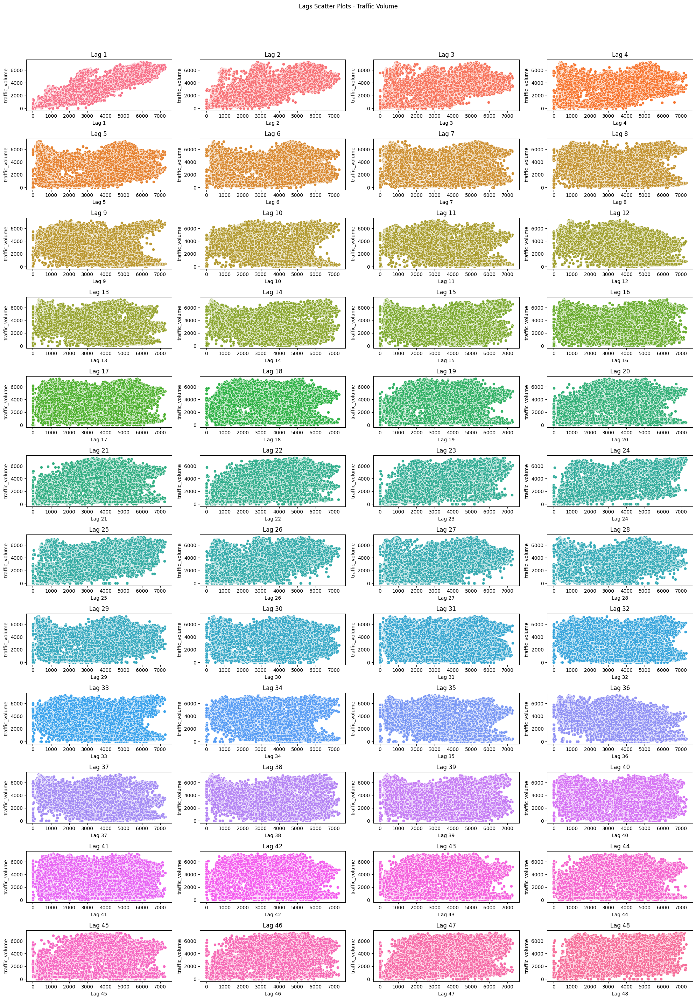

In [120]:
lags = 48
fig, axs = plt.subplots(12, 4, figsize=(20, 30))
fig.suptitle('Lags Scatter Plots - Traffic Volume')

for i in range(1, lags + 1):
    ax = axs[(i-1)//4, (i-1)%4]
    lag = df['traffic_volume'].shift(i)
    sns.scatterplot(
        x=lag, 
        y=df['traffic_volume'], 
        ax=ax,
        color=sns.color_palette("husl", lags)[i-1]
    )
    ax.set_title(f'Lag {i}')
    ax.set_xlabel(f'Lag {i}')
    ax.set_ylabel('traffic_volume')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

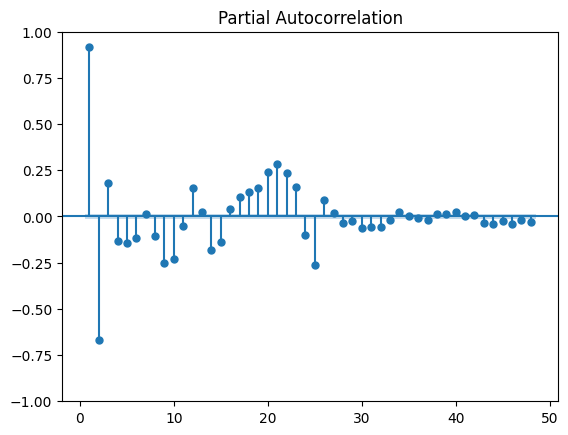

In [121]:
plot_pacf(df["traffic_volume"], lags=48, zero=False)
plt.show()

# 📊 Analyse des Lags et de l'Autocorrélation Partielle (PACF) du Volume de Trafic

Cette analyse vise à explorer la **dépendance temporelle** du volume de trafic à travers :
1. Les **scatter plots des lags** (jusqu’à 48 lags).
2. Le **graphique d’autocorrélation partielle (PACF)** pour identifier les relations directes entre les observations à différents retards (lags).

---

##  Scatter Plots des Lags
- **Lag 1 à Lag 4 :**
  - Forte **corrélation positive** visible, avec des points formant un nuage dense le long d’une diagonale ascendante.
  - Cela indique une **dépendance temporelle significative à court terme**, typique des séries temporelles avec des cycles de trafic réguliers (heures de pointe).

- **Lag 5 à Lag 24 :**
  - La corrélation diminue progressivement, mais des motifs linéaires sont encore perceptibles.
  - Cela reflète des **cycles intra-journaliers**, probablement liés aux schémas de trafic quotidiens.

- **Lag 25 à Lag 48 :**
  - La dispersion des points est plus importante, indiquant une **corrélation plus faible** à long terme.
  - Cependant, des **structures non aléatoires** persistent, suggérant des effets saisonniers hebdomadaires ou des schémas comportementaux répétitifs.


---

##  Graphique d'Autocorrélation Partielle (PACF)

### 🔍 Observations Clés :
- **Lag 1 :**
  - Pic d’autocorrélation partielle très élevé (~0.9), confirmant la **forte dépendance immédiate** des observations consécutives.
  - Cela indique qu'une grande partie de la variance du volume de trafic peut être expliquée par sa valeur précédente.

- **Lags 2 à 10 :**
  - Présence de **valeurs significatives positives et négatives**, mais de moindre amplitude que le lag 1.
  - Ces lags montrent des **relations directes plus faibles**, mais restent importants pour capturer la dynamique du trafic à court terme.

- **Lags 20 à 30 :**
  - Apparition de **pics significatifs autour du lag 20**, suggérant des **cycles saisonniers** potentiels liés à des motifs hebdomadaires (par exemple, des patterns de trafic similaires d'un jour à l'autre à la même heure).

- **Au-delà du lag 30 :**
  - L’autocorrélation tend vers zéro, indiquant un **affaiblissement des dépendances directes**.




---

- **Forte dépendance à court terme** (lags 1 à 4), essentielle pour la modélisation AR.
- **Effets saisonniers détectés** autour des lags multiples de 20, probablement liés à des cycles hebdomadaires ou quotidiens.
- La **décroissance progressive de la corrélation** confirme que les données présentent des schémas répétitifs à différentes échelles temporelles.

---


# 📊 Analyse de la Décomposition Saisonnière du Volume de Trafic

Cette décomposition saisonnière permet d'analyser le volume de trafic à travers ses différentes composantes : **observée**, **tendance**, **saisonnalité**, et **résidus**. L'objectif est de comprendre la structure sous-jacente des données et d'identifier des motifs récurrents ou des anomalies.

---

##  Observed (Données Observées)

- Le graphique montre les **données brutes du volume de trafic** sur la période analysée (2015-2018).
- On observe des **fluctuations régulières**, probablement liées à des **cycles journaliers et hebdomadaires**.
- Certains **creux soudains** peuvent indiquer des périodes de **données manquantes**, des jours fériés ou des événements exceptionnels (conditions météo extrêmes, accidents, etc.).

---

##  Trend (Tendance à Long Terme)

- La courbe de tendance révèle des **variations lentes** du trafic sur la période.
- **Tendance globale stable**, bien que des fluctuations soient visibles :
  - **Légère hausse** du volume de trafic vers la fin de la période, suggérant un possible **accroissement de la circulation**.
  - **Chutes soudaines** de la tendance à certains points (notamment vers mi-2016 et début 2018), probablement dues à des **perturbations majeures** ou des périodes de données manquantes.

- La tendance est influencée par des facteurs à long terme tels que la **croissance démographique**, les **modifications des infrastructures routières**, ou des **changements de comportement des usagers**.

---

##  Seasonal (Composante Saisonnière)

- La composante saisonnière est très **prononcée et régulière**, avec des motifs récurrents sur toute la période.
- On observe des **pics et des creux bien définis**, probablement liés à :
  - Des **heures de pointe quotidiennes** (matin et soir).
  - Des **cycles hebdomadaires** : trafic plus intense en semaine, plus faible le week-end.
  
- La saisonnalité est stable, ce qui indique des **habitudes de déplacement constantes** sur la période. 
- Ces motifs peuvent être exploités pour des **modèles de prévision du trafic**, car ils sont prévisibles et récurrents.

---

##  Residuals (Résidus)

- Les résidus représentent les **écarts entre les données réelles et les valeurs prédites par la tendance + saisonnalité**.
- Ils sont généralement **centrés autour de zéro**, ce qui est un bon signe d’un modèle bien ajusté.
- **Pics extrêmes** visibles dans les résidus :
  - Indiquent des **anomalies** ou des événements inattendus, comme des **accidents**, des **fermetures de routes**, des **manifestations**, ou des **conditions météorologiques extrêmes**.
- Les résidus permettent d'identifier des événements ponctuels non expliqués par des tendances régulières. 
- L’analyse de ces anomalies peut aider à comprendre les **facteurs externes** influençant le trafic.

---

- Le volume de trafic est fortement influencé par des **cycles saisonniers réguliers** (quotidiens et hebdomadaires).
- La **tendance à long terme** est relativement stable avec quelques perturbations ponctuelles.
- Les **résidus** mettent en évidence des anomalies qu'il serait intéressant d'explorer plus en détail.

---

In [122]:
print(df.index)
if not isinstance(df.index, pd.DatetimeIndex):
    df['date_time'] = pd.to_datetime(df['date_time'])
    df.set_index('date_time', inplace=True)
df = df.asfreq('h')

DatetimeIndex(['2015-10-27 08:00:00', '2015-10-27 09:00:00',
               '2015-10-27 10:00:00', '2015-10-27 11:00:00',
               '2015-10-27 12:00:00', '2015-10-27 13:00:00',
               '2015-10-27 14:00:00', '2015-10-27 15:00:00',
               '2015-10-27 16:00:00', '2015-10-27 17:00:00',
               ...
               '2018-09-30 14:00:00', '2018-09-30 15:00:00',
               '2018-09-30 16:00:00', '2018-09-30 17:00:00',
               '2018-09-30 18:00:00', '2018-09-30 19:00:00',
               '2018-09-30 20:00:00', '2018-09-30 21:00:00',
               '2018-09-30 22:00:00', '2018-09-30 23:00:00'],
              dtype='datetime64[ns]', name='date_time', length=25672, freq=None)


Statistic: -21.05568164119345, p-value: 0.0


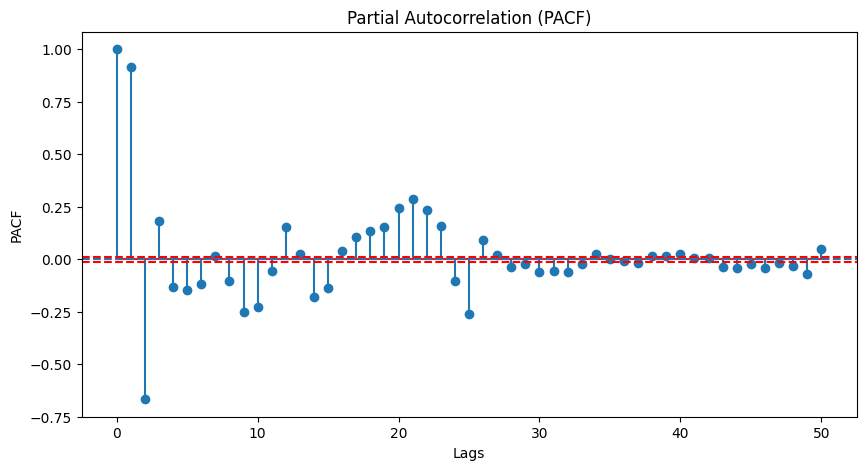

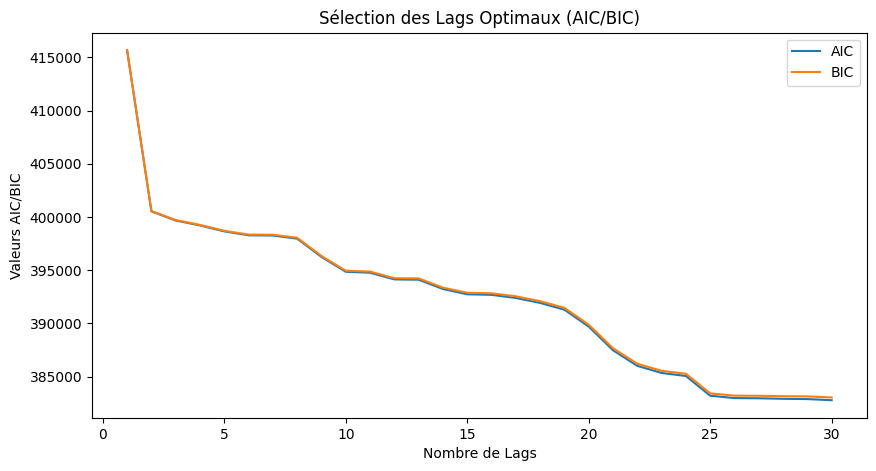

Meilleur lag selon AIC : 30
Meilleur lag selon BIC : 30


In [123]:
ts = df['traffic_volume']
result = adfuller(ts)
print(f'Statistic: {result[0]}, p-value: {result[1]}')

lag_pacf = pacf(ts, nlags=50, method='ols')

plt.figure(figsize=(10, 5))
plt.stem(range(len(lag_pacf)), lag_pacf)  
plt.axhline(y=0, linestyle='--')
plt.axhline(y=1.96/np.sqrt(len(ts)), linestyle='--', color='red')  
plt.axhline(y=-1.96/np.sqrt(len(ts)), linestyle='--', color='red')
plt.title('Partial Autocorrelation (PACF)')
plt.xlabel('Lags')
plt.ylabel('PACF')
plt.show()

aic_values = []
bic_values = []
max_lags = 30  

for lag in range(1, max_lags + 1):
    model = AutoReg(ts, lags=lag, old_names=False)
    result = model.fit()
    aic_values.append(result.aic)
    bic_values.append(result.bic)

plt.figure(figsize=(10, 5))
plt.plot(range(1, max_lags + 1), aic_values, label='AIC')
plt.plot(range(1, max_lags + 1), bic_values, label='BIC')
plt.xlabel('Nombre de Lags')
plt.ylabel('Valeurs AIC/BIC')
plt.title('Sélection des Lags Optimaux (AIC/BIC)')
plt.legend()
plt.show()


best_lag_aic = np.argmin(aic_values) + 1
best_lag_bic = np.argmin(bic_values) + 1

print(f"Meilleur lag selon AIC : {best_lag_aic}")
print(f"Meilleur lag selon BIC : {best_lag_bic}")


# 📊 Analyse des Résultats : PACF et Sélection des Lags Optimaux (AIC/BIC)

Cette analyse se concentre sur deux éléments clés pour la modélisation des séries temporelles du volume de trafic :
1. Le **Partial Autocorrelation Function (PACF)** pour détecter les dépendances directes avec les valeurs passées.
2. La **sélection des lags optimaux** à l’aide des critères d’information **AIC (Akaike Information Criterion)** et **BIC (Bayesian Information Criterion)**.

---

- Les lags **1 à 5** sont des candidats forts pour la modélisation, capturant les dépendances immédiates.
- Les **lags saisonniers (~20-25)** peuvent refléter des cycles journaliers ou hebdomadaires.
- **Pas besoin d’inclure des lags supérieurs à 30** dans la plupart des modèles, car ils n’apportent pas d’informations significatives.

---

## 2 Sélection des Lags Optimaux (AIC/BIC)

Le **graphe AIC/BIC** permet de choisir le **meilleur nombre de lags** en équilibrant la complexité du modèle et la qualité de l’ajustement.

- **AIC et BIC décroissent fortement jusqu’au lag 5 :**  
  Cela montre que les premiers lags apportent des informations significatives pour la modélisation.

- **Plateau entre les lags 10 et 20 :**  
  La diminution des valeurs ralentit, indiquant que **l’ajout de lags supplémentaires améliore peu la performance** du modèle.

- **Minimum autour du lag 25 :**  
  C’est le point où le modèle est le plus optimisé en termes de complexité et de performance.

- **AIC** favorise des modèles plus complexes car il pénalise moins la complexité.
- **BIC** est plus strict, favorisant des modèles plus simples.  
- Ici, **AIC et BIC convergent vers le même minimum (~lag 25)**, confirmant la robustesse de ce choix.

---
1. **Sélection des Lags :**
   - **Lags 1 à 5 :** Capturent les dépendances immédiates et sont essentiels pour des modèles simples.
   - **Lags 20 à 25 :** Capturent des effets saisonniers ou des cycles hebdomadaires.
   - **Lag optimal (selon AIC/BIC) : 25.**

---



**3. Features engineering**

In [124]:
lags = [1, 2, 3, 4, 5, 20, 24, 25,30]
for lag in lags:
    df[f'lag_{lag}'] = df['traffic_volume'].shift(lag)
df.dropna(inplace=True)

In [125]:
# Moyenne mobile
df['rolling_mean_daily'] = df['traffic_volume'].rolling(window=24).mean()         
df['rolling_mean_weekly'] = df['traffic_volume'].rolling(window=24*7).mean()      
df['rolling_mean_monthly'] = df['traffic_volume'].rolling(window=24*30).mean()    

# Médiane mobile
df['rolling_median_daily'] = df['traffic_volume'].rolling(window=24).median()         
df['rolling_median_weekly'] = df['traffic_volume'].rolling(window=24*7).median()      
df['rolling_median_monthly'] = df['traffic_volume'].rolling(window=24*30).median()   

# Écart-type mobile
df['rolling_std_daily'] = df['traffic_volume'].rolling(window=24).std()           
df['rolling_std_weekly'] = df['traffic_volume'].rolling(window=24*7).std()        
df['rolling_std_monthly'] = df['traffic_volume'].rolling(window=24*30).std()     


In [126]:
fig = make_subplots(rows=3, cols=1, shared_xaxes=True,
                    subplot_titles=("📅 Tendances Journalières", 
                                    "📆 Tendances Hebdomadaires", 
                                    "📅 Tendances Mensuelles"))

fig.add_trace(go.Scatter(x=df.index, y=df['traffic_volume'], mode='lines', name='Volume de Trafic', opacity=0.4), row=1, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_mean_daily'], mode='lines', name='Moyenne Mobile (24h)'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_median_daily'], mode='lines', name='Médiane Mobile (24h)', line=dict(dash='dash')), row=1, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_std_daily'], mode='lines', name='Écart-Type Mobile (24h)', line=dict(dash='dot')), row=1, col=1)

fig.add_trace(go.Scatter(x=df.index, y=df['traffic_volume'], mode='lines', name='Volume de Trafic', opacity=0.4, showlegend=False), row=2, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_mean_weekly'], mode='lines', name='Moyenne Mobile (7 jours)'), row=2, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_median_weekly'], mode='lines', name='Médiane Mobile (7 jours)', line=dict(dash='dash')), row=2, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_std_weekly'], mode='lines', name='Écart-Type Mobile (7 jours)', line=dict(dash='dot')), row=2, col=1)

fig.add_trace(go.Scatter(x=df.index, y=df['traffic_volume'], mode='lines', name='Volume de Trafic', opacity=0.4, showlegend=False), row=3, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_mean_monthly'], mode='lines', name='Moyenne Mobile (30 jours)'), row=3, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_median_monthly'], mode='lines', name='Médiane Mobile (30 jours)', line=dict(dash='dash')), row=3, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['rolling_std_monthly'], mode='lines', name='Écart-Type Mobile (30 jours)', line=dict(dash='dot')), row=3, col=1)

fig.update_layout(
    title="📊 Analyse Interactive des Tendances du Volume de Trafic",
    height=900,
    showlegend=True,
    hovermode='x unified'
)

fig.show()


# 📊 Analyse Interactive des Tendances du Volume de Trafic


##  **Tendances Journalières**

- **Pics réguliers** aux heures de pointe (matin et soir).
- **Forte volatilité** lors des jours de la semaine par rapport aux week-ends.

---

##  **Tendances Hebdomadaires**
- **Baisse du trafic** pendant les week-ends.
- Périodes de **volatilité accrue** autour des vacances et des jours fériés.

---

##  **Tendances Mensuelles**
- **Tendances saisonnières claires**, avec des périodes de trafic plus faible pendant l'été et des pics autour de la rentrée et des fêtes de fin d'année.
- **Stabilité accrue** du trafic sur certaines périodes prolongées.

---


D'autres features à tester:
- Encodage cyclique 
- TSFresh
- Target engineering (box-cox, differentiation)
- Intégrer les autres features de météo?

In [127]:
df['holiday'] = df['holiday'].apply(lambda x: 0 if x == 'None' else 1)

In [128]:
df['Hour'] = df.index.hour
df['Day'] = df.index.dayofweek  
df['Month'] = df.index.month
df['Weekend'] = (df['Day'] >= 5).astype(int) 
df['is_rush_hour'] = df['Hour'].isin([7, 8, 17, 18]).astype(int)  


**encodage cyclique**

In [129]:

df['Hour_sin'] = np.sin(2 * np.pi * df['Hour'] / 24)
df['Hour_cos'] = np.cos(2 * np.pi * df['Hour'] / 24)

df['Day_sin'] = np.sin(2 * np.pi * df['Day'] / 7)
df['Day_cos'] = np.cos(2 * np.pi * df['Day'] / 7)

df['Month_sin'] = np.sin(2 * np.pi * df['Month'] / 12)
df['Month_cos'] = np.cos(2 * np.pi * df['Month'] / 12)

** Features météo de base **

In [130]:
df['is_rain'] = (df['rain_1h'] > 0).astype(int)
df['is_snow'] = (df['snow_1h'] > 0).astype(int)
df['is_clear'] = (df['weather_main'] == 'Clear').astype(int)
df['temp_rain_interaction'] = df['temp'] * df['is_rain']
df['temp_snow_interaction'] = df['temp'] * df['is_snow']


**Index thermique (Heat Index)**

In [131]:
df['heat_index'] = df['temp'] - 0.55 * (1 - df['clouds_all']/100) * (df['temp'] - 14.5)

**Transformation de Box-Cox**

In [132]:
df['traffic_volume_boxcox'], _ = boxcox(df['traffic_volume'] + 1)  

**Différenciation (Differencing)**

In [133]:

df['traffic_volume_diff'] = df['traffic_volume'].diff()
df['traffic_volume_diff2'] = df['traffic_volume_diff'].diff()


In [134]:
df.dropna(inplace=True)
# df.drop(columns=['holiday'], inplace=True)

In [135]:
categorical_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
df_encoded = pd.get_dummies(df, columns=categorical_cols, drop_first=True)
# df_encoded = df_encoded.astype({col: int for col in df_encoded.select_dtypes(include=['bool']).columns})


In [136]:
# from tsfresh.utilities.dataframe_functions import make_forecasting_frame
# from tsfresh import extract_features

# # 🔹 Étape 1 : Transformer les données pour TSFresh
# df_tsfresh, y = make_forecasting_frame(
#     df_encoded['traffic_volume'],  # La colonne cible
#     kind="traffic",
#     max_timeshift=24,  # Dépend du nombre de lags
#     rolling_direction=1
# )

# print("✅ Format TSFresh OK :")
# print(df_tsfresh.head())  # Vérifier la structure

In [137]:
# # Vérifier et convertir les types de colonnes
# df_tsfresh["id"] = df_tsfresh["id"].astype(str)  # S'assurer que l'id est une chaîne de caractères
# df_tsfresh_cleaned = df_tsfresh.drop(columns=["kind"])

# extracted_features = extract_features(
#     df_tsfresh_cleaned,
#     column_id="id",  
#     column_sort="time"
# )

# print("✅ Features extraites avec succès !")
# print(extracted_features.head())


In [139]:
# from tsfresh.utilities.dataframe_functions import impute

# # 📌 Vérifier les index avant correction
# print("📌 Type de index extracted_features :", type(extracted_features.index))
# print("📌 Type de index y :", type(y.index))

# print("📌 Exemple de valeurs extracted_features.index :", extracted_features.index[:5])
# print("📌 Exemple de valeurs y.index :", y.index[:5])

# # 🚀 Étape 1 : Transformer extracted_features.index pour correspondre à y.index
# # Supprimer les caractères spéciaux dans extracted_features.index
# extracted_features.index = extracted_features.index.astype(str).str.extract(r'(\d+)')[0].astype(int)

# # 🚀 Étape 2 : Supprimer les valeurs NaN
# extracted_features = impute(extracted_features)

# # 🚀 Étape 3 : Réaligner les index
# extracted_features = extracted_features.loc[y.index]

# # 🚀 Étape 4 : Sélectionner les features pertinentes
# selected_features = select_features(extracted_features, y)

# print("✅ Features sélectionnées avec succès !")
# print(selected_features.head())


In [140]:
# # 🔹 Étape 4 : Ajouter les features sélectionnées au dataset d'origine
# df_final = df_encoded.merge(selected_features, left_index=True, right_index=True, how='left')

# print("✅ Nouveau dataset avec les features TSFresh ajoutées :")
# print(df_final.head())

In [141]:
correlation_matrix = df_encoded.corr()


threshold = 0.5  
filtered_corr = correlation_matrix[(correlation_matrix >= threshold) | (correlation_matrix <= -threshold)]
filtered_corr_df = filtered_corr.stack().reset_index()
filtered_corr_df.columns = ['Variable 1', 'Variable 2', 'Correlation']

filtered_corr_df = filtered_corr_df[
    (filtered_corr_df['Variable 1'] != filtered_corr_df['Variable 2']) &
    (filtered_corr_df['Correlation'].abs() >= threshold)
].drop_duplicates(subset=['Correlation'])

sorted_filtered_corr_df=filtered_corr_df.sort_values(by="Correlation", ascending=False)
sorted_filtered_corr_df.head(10)

,Variable 1,Variable 2,Correlation
227,weather_main_Fog,weather_description_fog,1.000000
194,is_snow,temp_snow_interaction,0.999952
191,is_rain,temp_rain_interaction,0.999816
18,traffic_volume,traffic_volume_boxcox,0.996310
9,clouds_all,heat_index,0.988726
107,rolling_mean_daily,rolling_median_daily,0.962486
121,rolling_mean_monthly,rolling_median_monthly,0.927423
238,weather_main_Snow,weather_description_light snow,0.927006
113,rolling_mean_weekly,rolling_median_weekly,0.917085
199,is_clear,weather_description_sky is clear,0.916792


In [142]:
variables_to_drop = [
    'weather_description_fog',
    'heat_index',
    'weather_description_light snow',
    'weather_description_proximity thunderstorm'
]

df_cleaned = df_encoded.drop(columns=variables_to_drop)
df_cleaned.shape


(24854, 83)

In [143]:
df_encoded.columns.tolist()

['holiday',
 'temp',
 'rain_1h',
 'snow_1h',
 'clouds_all',
 'traffic_volume',
 'smooth_traffic_volume',
 'Hour',
 'Day',
 'Month',
 'lag_1',
 'lag_2',
 'lag_3',
 'lag_4',
 'lag_5',
 'lag_20',
 'lag_24',
 'lag_25',
 'lag_30',
 'rolling_mean_daily',
 'rolling_mean_weekly',
 'rolling_mean_monthly',
 'rolling_median_daily',
 'rolling_median_weekly',
 'rolling_median_monthly',
 'rolling_std_daily',
 'rolling_std_weekly',
 'rolling_std_monthly',
 'Weekend',
 'is_rush_hour',
 'Hour_sin',
 'Hour_cos',
 'Day_sin',
 'Day_cos',
 'Month_sin',
 'Month_cos',
 'is_rain',
 'is_snow',
 'is_clear',
 'temp_rain_interaction',
 'temp_snow_interaction',
 'heat_index',
 'traffic_volume_boxcox',
 'traffic_volume_diff',
 'traffic_volume_diff2',
 'weather_main_Clouds',
 'weather_main_Drizzle',
 'weather_main_Fog',
 'weather_main_Haze',
 'weather_main_Mist',
 'weather_main_Rain',
 'weather_main_Smoke',
 'weather_main_Snow',
 'weather_main_Thunderstorm',
 'weather_description_broken clouds',
 'weather_descriptio

In [144]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(df_cleaned['traffic_volume'].dropna())

adf_statistic = result[0]
p_value = result[1]
critical_values = result[4]

(adf_statistic, p_value, critical_values)


(-21.978407757903515,
 0.0,
 {'1%': -3.430613655587482,
  '5%': -2.861656527746683,
  '10%': -2.5668320243194236})

**Puisque la série est stationnaire, nous pouvons passer à la modélisation**

## Modèle AR (Auto-Régressif)

c:\Users\lbenzemma\Desktop\Projets Master2 MOSEF\Projet Time Series\MOSEF---Projet-Time-Series\env\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



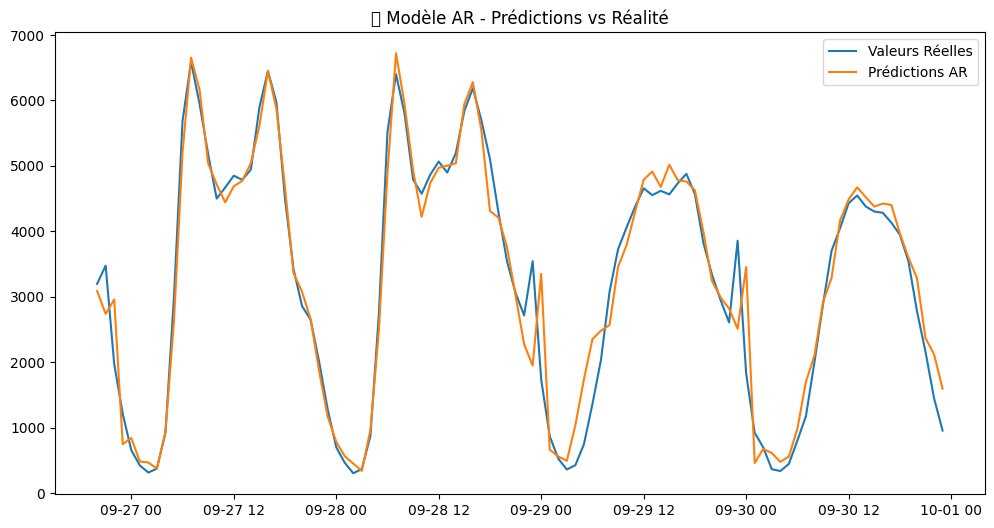

In [48]:
from statsmodels.tsa.ar_model import AutoReg

ar_model = AutoReg(df_cleaned['traffic_volume'], lags=25)  
ar_result = ar_model.fit()

ar_pred = ar_result.predict(start=len(df_cleaned) - 100, end=len(df_cleaned) - 1)
plt.figure(figsize=(12, 6))
plt.plot(df_cleaned['traffic_volume'].tail(100), label='Valeurs Réelles')
plt.plot(ar_pred, label='Prédictions AR')
plt.legend()
plt.title('📈 Modèle AR - Prédictions vs Réalité')
plt.show()


## Modèle ARIMA

c:\Users\lbenzemma\Desktop\Projets Master2 MOSEF\Projet Time Series\MOSEF---Projet-Time-Series\env\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\Users\lbenzemma\Desktop\Projets Master2 MOSEF\Projet Time Series\MOSEF---Projet-Time-Series\env\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



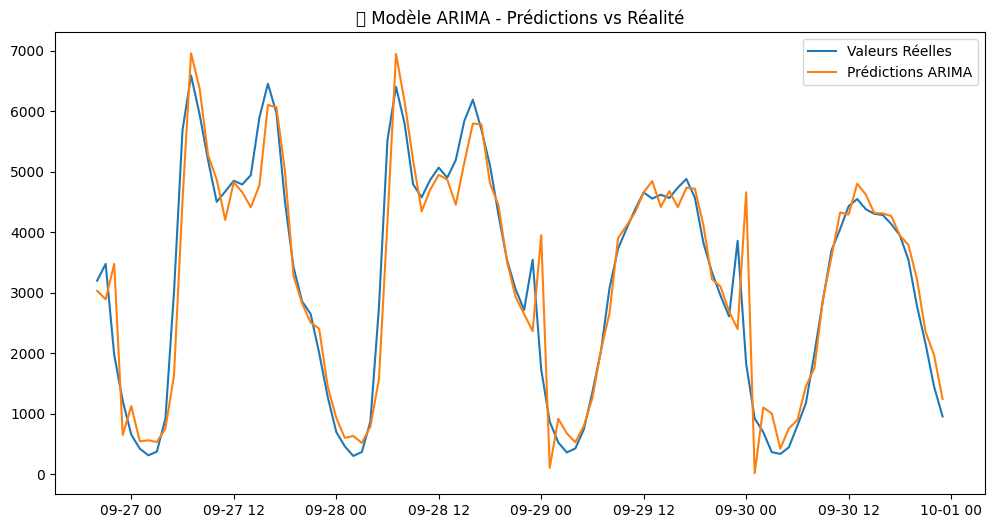

In [57]:
from statsmodels.tsa.arima.model import ARIMA
df_cleaned1=df_cleaned.drop(columns=[ 'traffic_volume_boxcox', 'traffic_volume_diff', 'traffic_volume_diff2'])
arima_model = ARIMA(df_cleaned1['traffic_volume'], order=(5, 0, 2)) 
arima_result = arima_model.fit()


arima_pred = arima_result.predict(start=len(df_cleaned) - 100, end=len(df_cleaned) - 1, typ='levels')
plt.figure(figsize=(12, 6))
plt.plot(df_cleaned['traffic_volume'].tail(100), label='Valeurs Réelles')
plt.plot(arima_pred, label='Prédictions ARIMA')
plt.legend()
plt.title('📈 Modèle ARIMA - Prédictions vs Réalité')
plt.show()


## XGBOOST

In [156]:
from sklearn.model_selection import train_test_split
import xgboost as xgb
import numpy as np

features = df_cleaned.drop(columns=['traffic_volume'])  # Suppression de la cible
target = df_cleaned['traffic_volume']

train_size = int(0.8 * len(df_encoded))
X_train, X_test = features.iloc[:train_size], features.iloc[train_size:]
y_train, y_test = target.iloc[:train_size], target.iloc[train_size:]


In [157]:
print(f"Taille du dataset : {len(df_cleaned)}")
print(f"Taille du train set : {len(X_train)}")
print(f"Taille du test set : {len(X_test)}")


Taille du dataset : 24854
Taille du train set : 19883
Taille du test set : 4971


In [158]:
print(f"Première date du train set : {df_cleaned.index[0]}")
print(f"Dernière date du train set : {df_cleaned.index[train_size-1]}")
print(f"Première date du test set : {df_cleaned.index[train_size]}")
print(f"Dernière date du test set : {df_cleaned.index[-1]}")


Première date du train set : 2015-11-30 10:00:00
Dernière date du train set : 2018-03-07 20:00:00
Première date du test set : 2018-03-07 21:00:00
Dernière date du test set : 2018-09-30 23:00:00


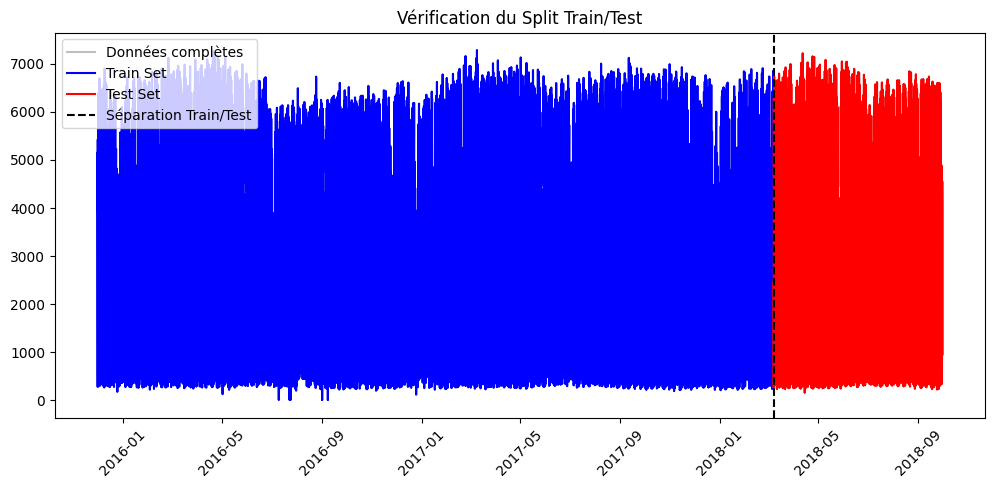

In [159]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 5))
plt.plot(df_cleaned.index, df_cleaned['traffic_volume'], label="Données complètes", color="gray", alpha=0.5)
plt.plot(X_train.index, y_train, label="Train Set", color="blue")
plt.plot(X_test.index, y_test, label="Test Set", color="red")
plt.axvline(df_cleaned.index[train_size], color="black", linestyle="--", label="Séparation Train/Test")
plt.legend()
plt.title("Vérification du Split Train/Test")
plt.xticks(rotation=45)
plt.show()


In [151]:
# Paramètres du modèle
xgb_model = xgb.XGBRegressor(
    objective="reg:squarederror",
    n_estimators=100,
    learning_rate=0.1,
    max_depth=6
)

# Entraînement
xgb_model.fit(X_train, y_train)

# Prédictions
y_pred = xgb_model.predict(X_test)


In [152]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"📊 MAE: {mae:.2f}, RMSE: {rmse:.2f}")


📊 MAE: 7.15, RMSE: 10.81


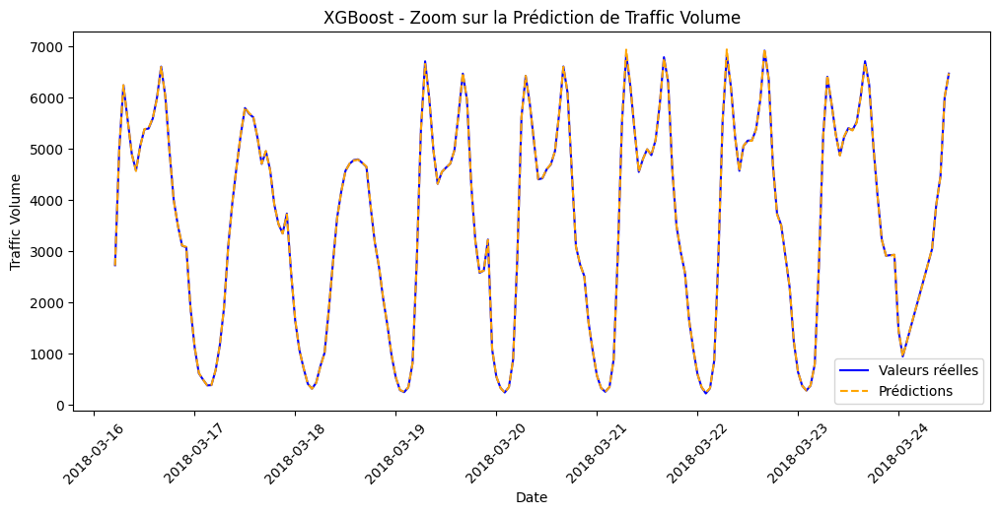

In [162]:
# Définir une période spécifique (ex: 200 premières valeurs du test set)
start_zoom = 200
end_zoom = 400

plt.figure(figsize=(12, 5))
plt.plot(y_test.index[start_zoom:end_zoom], y_test.values[start_zoom:end_zoom], label="Valeurs réelles", color="blue")
plt.plot(y_test.index[start_zoom:end_zoom], y_pred[start_zoom:end_zoom], label="Prédictions", linestyle="dashed", color="orange")
plt.legend()
plt.title("XGBoost - Zoom sur la Prédiction de Traffic Volume")
plt.xlabel("Date")
plt.ylabel("Traffic Volume")
plt.xticks(rotation=45)
plt.show()


## Random Forest

In [163]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Définition du modèle
rf_model = RandomForestRegressor(
    n_estimators=100, 
    max_depth=10,  
    random_state=42,  
    n_jobs=-1  
)

rf_model.fit(X_train, y_train)

y_pred_rf = rf_model.predict(X_test)

mae_rf = mean_absolute_error(y_test, y_pred_rf)
mse_rf = mean_squared_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(mse_rf)
r2_rf = r2_score(y_test, y_pred_rf)

print(f"📊 Performance du Random Forest:")
print(f"🔹 MAE  (Mean Absolute Error) : {mae_rf:.2f}")
print(f"🔹 RMSE (Root Mean Squared Error) : {rmse_rf:.2f}")
print(f"🔹 R² Score : {r2_rf:.2f}")


📊 Performance du Random Forest:
🔹 MAE  (Mean Absolute Error) : 0.52
🔹 RMSE (Root Mean Squared Error) : 0.95
🔹 R² Score : 1.00


c:\Users\chemm\OneDrive\Bureau\cours\MOSEF\Time_series\.venv_TimeSeries\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



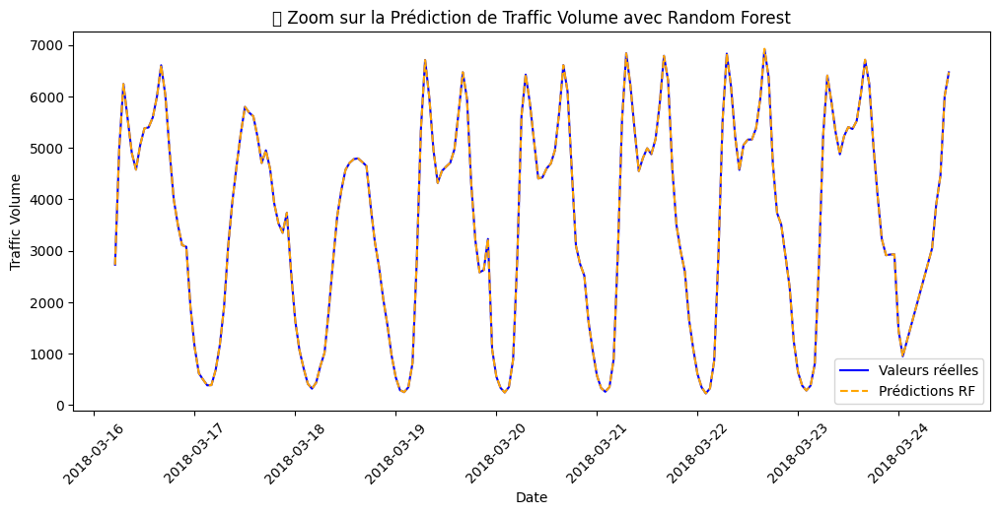

In [164]:
start_zoom = 200
end_zoom = 400

plt.figure(figsize=(12, 5))
plt.plot(y_test.index[start_zoom:end_zoom], y_test.values[start_zoom:end_zoom], label="Valeurs réelles", color="blue")
plt.plot(y_test.index[start_zoom:end_zoom], y_pred_rf[start_zoom:end_zoom], label="Prédictions RF", linestyle="dashed", color="orange")
plt.legend()
plt.title("🔍 Zoom sur la Prédiction de Traffic Volume avec Random Forest")
plt.xlabel("Date")
plt.ylabel("Traffic Volume")
plt.xticks(rotation=45)
plt.show()


## LSTM

In [166]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
import numpy as np

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

def create_sequences(X, y, time_steps=10):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:i + time_steps])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 10  
X_train_lstm, y_train_lstm = create_sequences(X_train_scaled, y_train, time_steps)
X_test_lstm, y_test_lstm = create_sequences(X_test_scaled, y_test, time_steps)

print(f"✅ Dimensions LSTM : {X_train_lstm.shape}, {y_train_lstm.shape}")


C:\Users\chemm\AppData\Local\Temp\ipykernel_53884\2051584051.py:15: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



✅ Dimensions LSTM : (19873, 10, 82), (19873,)


In [170]:
from sklearn.preprocessing import MinMaxScaler
import numpy as np

# 🎯 Création d'un scaler spécifique pour la variable cible
scaler_y = MinMaxScaler()
y_train_scaled = scaler_y.fit_transform(y_train.values.reshape(-1, 1))
y_test_scaled = scaler_y.transform(y_test.values.reshape(-1, 1))

# 🟠 Reshape des données pour LSTM
time_steps = 10  

def create_sequences(X, y, time_steps):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:i + time_steps])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

X_train_lstm, y_train_lstm = create_sequences(X_train_scaled, y_train_scaled, time_steps)
X_test_lstm, y_test_lstm = create_sequences(X_test_scaled, y_test_scaled, time_steps)

# 🎯 Définition du modèle LSTM
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

model_lstm = Sequential([
    LSTM(units=50, return_sequences=True, input_shape=(time_steps, X_train.shape[1])),
    LSTM(units=50, return_sequences=False),
    Dense(units=25, activation='relu'),
    Dense(units=1)
])

# 🟢 Compilation et entraînement
model_lstm.compile(optimizer='adam', loss='mse')
model_lstm.fit(X_train_lstm, y_train_lstm, epochs=20, batch_size=32, validation_data=(X_test_lstm, y_test_lstm))

# 🟢 Prédictions
y_pred_lstm = model_lstm.predict(X_test_lstm)

# 🛠 Correction : Inverser uniquement la variable cible
y_pred_lstm = scaler_y.inverse_transform(y_pred_lstm)

print("✅ Prédictions LSTM terminées !")


Epoch 1/20


c:\Users\chemm\OneDrive\Bureau\cours\MOSEF\Time_series\.venv_TimeSeries\Lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



622/622 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0251 - val_loss: 0.0032
Epoch 2/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0035 - val_loss: 0.0030
Epoch 3/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0027 - val_loss: 0.0023
Epoch 4/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0022 - val_loss: 0.0021
Epoch 5/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0020 - val_loss: 0.0025
Epoch 6/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0018 - val_loss: 0.0017
Epoch 7/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 8/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0015 - val_loss: 0.0014
Epoch 9/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0015 - val_loss: 0.0011
Epoch 10/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 11/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0014 - val_loss: 0.0010
Epoch 12/20
622/622 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.

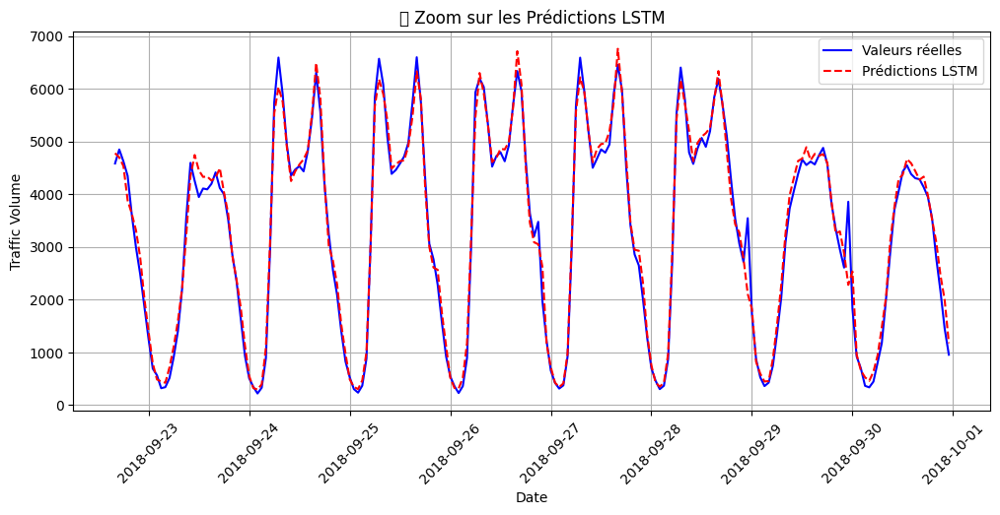

In [ ]:
import matplotlib.pyplot as plt
zoom_start = -200  

plt.figure(figsize=(12, 5))
plt.plot(y_test.index[time_steps:][zoom_start:], y_test.values[time_steps:][zoom_start:], label="Valeurs réelles", color="blue")
plt.plot(y_test.index[time_steps:][zoom_start:], y_pred_lstm[zoom_start:], label="Prédictions LSTM", linestyle="dashed", color="red")

# 📌 Améliorer la lisibilité
plt.legend()
plt.title("🔍 Zoom sur les Prédictions LSTM")
plt.xlabel("Date")
plt.ylabel("Traffic Volume")
plt.xticks(rotation=45) 
plt.grid(True) 
plt.show()


## CatBoost

In [174]:
from catboost import CatBoostRegressor

catboost_model = CatBoostRegressor(
    iterations=500,  
    learning_rate=0.1,  
    depth=6,  
    loss_function='RMSE',  
    verbose=100
)

catboost_model.fit(X_train, y_train)

y_pred_catboost = catboost_model.predict(X_test)

print("✅ Prédictions CatBoost terminées !")


0:	learn: 1771.3136028	total: 166ms	remaining: 1m 23s
100:	learn: 38.8858591	total: 726ms	remaining: 2.87s
200:	learn: 26.2935500	total: 1.28s	remaining: 1.91s
300:	learn: 21.3238403	total: 2.01s	remaining: 1.33s
400:	learn: 18.4513763	total: 2.7s	remaining: 666ms
499:	learn: 16.4779620	total: 3.38s	remaining: 0us
✅ Prédictions CatBoost terminées !


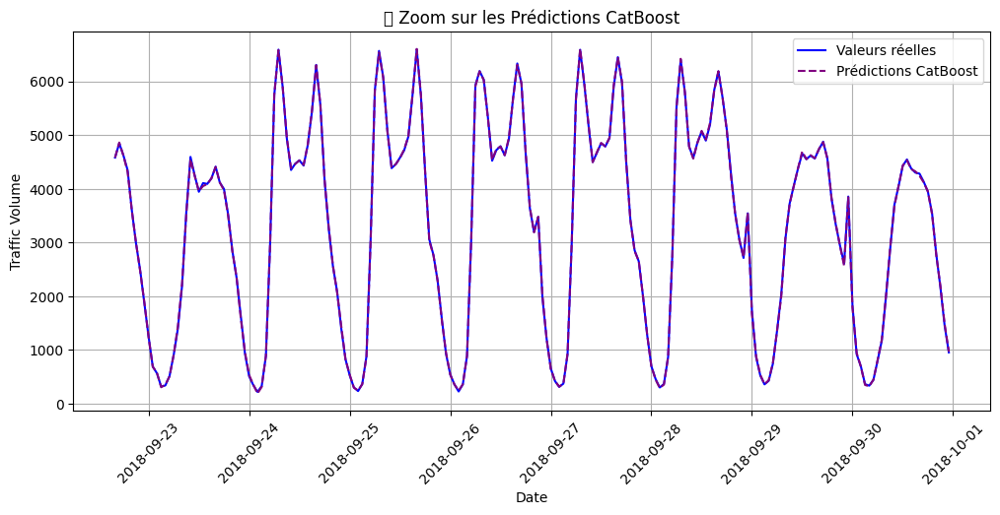

In [ ]:
import matplotlib.pyplot as plt

zoom_start = -200  

plt.figure(figsize=(12, 5))
plt.plot(y_test.index[zoom_start:], y_test.values[zoom_start:], label="Valeurs réelles", color="blue")
plt.plot(y_test.index[zoom_start:], y_pred_catboost[zoom_start:], label="Prédictions CatBoost", linestyle="dashed", color="purple")

plt.legend()
plt.title("🔍 Zoom sur les Prédictions CatBoost")
plt.xlabel("Date")
plt.ylabel("Traffic Volume")
plt.xticks(rotation=45)  
plt.grid(True) 
plt.show()
